In [1]:
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np
from typing import List, Tuple, Set
from sklearn import metrics
from sklearn import mixture
import collections
from sklearn.neighbors import KNeighborsClassifier
from skimage.feature import local_binary_pattern

In [2]:
def hog_compute(img: np.ndarray, cell_size: Tuple[int, int], block_size: Tuple[int, int], 
                nbins: int) -> np.ndarray:
    # create HoG Object
    # winSize is the size of the image cropped to multiple of the cell size
    # all arguments should be given in terms of number of pixels
    hog = cv2.HOGDescriptor(_winSize=((img.shape[1] // cell_size[1]) * cell_size[1],
                            (img.shape[0] // cell_size[0]) * cell_size[0]),
                            _blockSize=(block_size[1] * cell_size[1],
                                        block_size[0] * cell_size[0]),
                            _blockStride=(cell_size[1], cell_size[0]),
                            _cellSize=(cell_size[1], cell_size[0]),
                            _nbins=nbins)

    n_cells = (img.shape[0] // cell_size[0], img.shape[1] // cell_size[1])

    # Compute HoG features
    hog_feats = hog.compute(img) \
                   .reshape(n_cells[1] - block_size[1] + 1,
                            n_cells[0] - block_size[0] + 1,
                            block_size[1], block_size[0], nbins) \
                   .transpose((1, 0, 3, 2, 4)).flatten()  # index blocks by rows first
    return hog_feats

def compute_lbp(img: np.ndarray, radius: int) -> np.ndarray:
    return local_binary_pattern(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), 
                                8 * radius, radius, method='uniform').flatten()

In [3]:
"""
Reference
https://docs.opencv.org/3.4/db/d28/tutorial_cascade_classifier.html
"""
dfxs = {"Testing_Images /Yuxiang/down_r30.png": (1400, 875, 600, 600), 
        "Testing_Images /Yuxiang/hat.png": (1100, 1200, 700, 700), 
        "Testing_Images /Yuxiang/down_l45.png": (1000, 1100, 400, 400), 
        "Testing_Images /Yuxiang/down_r45.png": (1500, 900, 600, 600), 
        "Testing_Images /Yuxiang/down_0.png": (1250, 800, 600, 600), 
        "Testing_Images /Yuxiang/glass.png": (1000, 1100, 800, 800),
        "Testing_Images /Yuxiang/happy.png": (1100, 875, 700, 700),
        "Testing_Images /Yuxiang/surprised.png": (1100, 1050, 700, 700), 
        "Testing_Images /Yuxiang/up_l45.png": (1000, 1100, 600, 600), 
        "Testing_Images /Yuxiang/up_r45.png": (1500, 1000, 600, 600),
        "Testing_Images /Yuxiang/up_0.png":(1250,900,550,550),
        "Testing_Images /Yuxiang/down_l30.png":(1050,1100,500,500),
        "Testing_Images /Yuxiang/up_r30.png":(1300,1000,550,550), 
        "Testing_Images /Yuxiang/up_l30.png":(1100,1050,600,600),
    #===================================================================   
        "Training_Images/Sherry/r30_normal.png": (1400, 1000, 600, 600), 
        "Training_Images/Sherry/l30_normal.png": (1100, 900, 600, 600),
        "Training_Images/Sherry/r45_normal.png": (1500, 1100, 500, 500), 
        "Training_Images/Sherry/r45_large.png": (1600, 850, 800, 800),
        "Training_Images/Sherry/0_normal.png": (1250, 950, 550, 550),
        "Training_Images/Sherry/0_small.png": (1250, 1100, 480, 480),
        "Training_Images/Sherry/0_large.png": (1100, 870, 800, 800), 
        "Training_Images/Sherry/l30_large.png": (900, 800, 900, 900), 
        "Training_Images/Sherry/l45_normal.png": (1000, 1000, 600, 600), 
        "Training_Images/Sherry/l45_large.png": (850, 750, 850, 850), 
        "Training_Images/Sherry/l45_small.png": (1100, 1000, 500, 500), 
        "Training_Images/Sherry/r45_small.png": (1300, 950, 500, 500),
        "Training_Images/Sherry/r30_large.png": (1250,900,850,850),
        "Training_Images/Sherry/r30_small.png": (1400,950,550,550),
        "Training_Images/Sherry/l30_small.png":(1200,1000,500,500),
    #=================================================================
        "Testing_Images /Sherry/down_r30.png": (1500, 1000, 500, 500), 
        "Testing_Images /Sherry/hat.png": (1250, 1100, 550, 550), 
        "Testing_Images /Sherry/down_l45.png": (850, 1000, 500, 500), 
        "Testing_Images /Sherry/down_r45.png": (1000, 1500, 500, 500), 
        "Testing_Images /Sherry/down_0.png": (1100, 1000, 600, 600), 
        "Testing_Images /Sherry/glass.png": ( 750,1250, 500, 500),
        "Testing_Images /Sherry/happy.png": (900,1400, 700, 700),
        "Testing_Images /Sherry/surprised.png": (900,1300, 800, 800), 
        "Testing_Images /Sherry/up_l45.png": (800,750,750, 750), 
        "Testing_Images /Sherry/up_r45.png": (1400,700,800,800),
        "Testing_Images /Sherry/up_l30.png": (900,750,750,750),
        "Testing_Images /Sherry/up_r30.png":(1250,600,700,700),
        "Testing_Images /Sherry/up_0.png": (1100,800,700,700),
        "Testing_Images /Sherry/down_l30.png": (1000,1000,600,600),
      #===============================================================  
        "Testing_Images /Tingzhe/down_r30.png": (1400, 1200, 800, 800), 
        "Testing_Images /Tingzhe/hat.png": (1200, 700, 800, 800), 
        "Testing_Images /Tingzhe/down_l45.png": (1300, 1200, 400, 400), 
        "Testing_Images /Tingzhe/down_r45.png": (1600, 1000, 800, 500), 
        "Testing_Images /Tingzhe/down_0.png": (1100, 900, 700, 700), 
        "Testing_Images /Tingzhe/glass.png": (1200, 700, 600, 600),
        "Testing_Images /Tingzhe/happy.png": (1200, 700, 800, 800),
        "Testing_Images /Tingzhe/surprised.png": (1300, 700, 700, 700), 
        "Testing_Images /Tingzhe/up_l45.png": (1100, 600, 800, 800), 
        "Testing_Images /Tingzhe/up_r45.png": (1600, 600, 800, 800),
        "Testing_Images /Tingzhe/up_0.png": (1000, 500, 700, 700), 
        "Testing_Images /Tingzhe/down_l30.png": (1300, 1200, 700, 700), 
        "Testing_Images /Tingzhe/up_r30.png": (1400, 600, 700, 700), 
        "Testing_Images /Tingzhe/up_l30.png": (1100, 600, 600, 600),
     #================================================================   
        "Training_Images/Fandi/r45_normal.png":(600,400,300,300),
        "Training_Images/Fandi/r30_normal.png": (600, 400, 300, 300), 
        "Training_Images/Fandi/l30_normal.png": (450, 400, 250, 250), 
        "Training_Images/Fandi/l45_large.png": (300, 400, 400, 400), 
        "Training_Images/Fandi/r30_small.png": (1500,1050,500,500), 
        "Training_Images/Fandi/r30_large.png": (600, 300, 400, 400), 
        "Training_Images/Fandi/l45_small.png": (1100, 1100, 600, 600),
        "Training_Images/Fandi/0_large.png": (400, 300, 400, 400),
        "Training_Images/Fandi/l30_large.png": (350, 300, 450, 450),
        "Training_Images/Fandi/l30_small .png":(1200,1100,500,500),
        "Training_Images/Fandi/0_small.png": (1250, 1100, 500, 500), 
        "Training_Images/Fandi/l45_normal.png": (400, 450, 300, 300),
        "Training_Images/Fandi/r45_large.png": (650, 300, 400, 400),
        "Training_Images/Fandi/r45_small.png": (1500,1100, 500, 500),
        "Training_Images/Fandi/0_normal.png":(500,400,270,270),
      #================================================================       
        "Testing_Images /Fandi/down_r30.png": (1250, 1000, 500, 500), 
        "Testing_Images /Fandi/hat.png": (1250, 1100, 500, 500), 
        "Testing_Images /Fandi/down_l45.png": (1050, 1000, 500, 500), 
        "Testing_Images /Fandi/down_r45.png": (1450, 1050, 450, 450), 
        "Testing_Images /Fandi/down_0.png": (1100, 1200, 400, 400), 
        "Testing_Images /Fandi/glass.png": ( 1250,1100, 500, 500),
        "Testing_Images /Fandi/happy.png": (1400,1050, 500, 500),
        "Testing_Images /Fandi/surprised.png": (1250,750, 500, 500), 
        "Testing_Images /Fandi/up_l45.png": (1200,1050,450, 450), 
        "Testing_Images /Fandi/up_r45.png": (1500,1150,400,400),
        "Testing_Images /Fandi/up_l30.png":(1400,1050,400,400),
        "Testing_Images /Fandi/up_0.png":(1300,1000,400,400),
        "Testing_Images /Fandi/down_l30.png":(1250,1400,350,350),
        "Testing_Images /Fandi/up_r30.png":(1400,1050,350,350),
        "Testing_Images /Fandi/up_l30.png": (1450,1050,450,450),
       #============================================================
        "Training_Images/Tingzhe/0_large.png":(400,500,500,500),
        "Training_Images/Tingzhe/0_normal.png":(450,300,360,360),
        "Training_Images/Tingzhe/0_small.png":(1200,500,600,600),
        "Training_Images/Tingzhe/l30_large.png":(250,450,550,550),
        "Training_Images/Tingzhe/l30_normal.png":(450,350,400,400),
        "Training_Images/Tingzhe/l30_small.png":(1300,500,500,500),
        "Training_Images/Tingzhe/l45_large.png":(380,620,550,550),
        "Training_Images/Tingzhe/l45_normal.png":(290,420,310,310),
        "Training_Images/Tingzhe/r30_large.png":(450,600,450,450),
        "Training_Images/Tingzhe/r30_normal.png":(450,500,400,400),
        "Training_Images/Tingzhe/r30_small.png":(1300,900,700,700),
        "Training_Images/Tingzhe/r45_large.png": (500,550,600,600),
        "Training_Images/Tingzhe/r45_normal.png":(620,430,400,400),
        "Training_Images/Tingzhe/r45_small.png":(1700,700,700,700),
        "Training_Images/Tingzhe/l45_small.png": (1250,500,750,750),
        #===========================================================
        "Testing_Images /Menghan/down_0.png": (1100,700,1000,1000), 
        "Testing_Images /Menghan/down_l30.png": (1100,800,700,700),  
        "Testing_Images /Menghan/down_r30.png": (1400,700,600,600),
        "Testing_Images /Menghan/glass.png": (1000,900,600,600),            
        "Testing_Images /Menghan/happy.png": (1100,1100,900,900),
        "Testing_Images /Menghan/hat.png": (1200,1200,500,500),
        "Testing_Images /Menghan/surprised.png": (1200,800,800,800),
        "Testing_Images /Menghan/up_0.png": (1200,900,600,600),
        "Testing_Images /Menghan/up_l30.png": (1100,700,600,600),
        "Testing_Images /Menghan/up_l45.png": (1100,700,500,500),
        "Testing_Images /Menghan/up_r30.png": (1400,700,500,500),
        "Testing_Images /Menghan/down_l45.png": (1000,800,700,700),
        "Testing_Images /Menghan/down_r45.png": (1300,750,650,650),
        "Testing_Images /Menghan/up_r45.png": (1250,750,650,650),

        #============================================================
        "Training_Images/Menghan/r45_small.png": (1000,900,750,750),
        "Training_Images/Menghan/r45_normal.png": (300,300,450,450),
        "Training_Images/Menghan/r30_normal.png": (450,50,450,450), 
        "Training_Images/Menghan/l30_normal.png": (400, 200, 400, 400), 
        "Training_Images/Menghan/l45_large.png": (250, 200, 600, 600), 
        "Training_Images/Menghan/r30_small.png": (1100, 500, 750, 750), 
        "Training_Images/Menghan/r30_large.png": (300, 100, 700, 700), 
        "Training_Images/Menghan/l45_small.png": (1250, 500, 750, 750),
        "Training_Images/Menghan/0_large.png": (300, 100, 600, 600),
        "Training_Images/Menghan/l30_large.png": (300, 200, 600, 600), 
        "Training_Images/Menghan/0_small.png":(1100,950,650,650),
        "Training_Images/Menghan/l45_normal.png": (500,100,450,450),
        "Training_Images/Menghan/r45_large.png": (500, 100, 600, 600),
        "Training_Images/Menghan/l30_small.png": (1250,750,650,650),
        "Training_Images/Menghan/0_normal.png":(400,300,400,400)

       }

def keypoints_sift(img: np.ndarray, sift: cv2.xfeatures2d_SIFT) -> Set[Tuple[int, int]]:
    return set(map(lambda kp: (int(kp.pt[0]), int(kp.pt[1])), sift.detect(img, None)))

def keypoints_harris(img: np.ndarray, fthr: float) -> Set[Tuple[int, int]]:
    # print(img.shape)
    dst = cv2.cornerHarris(img, 2, 3, 0.04)
    dst = cv2.dilate(dst,None)
    return set([(d[1], d[0]) for d in list(np.argwhere(dst > fthr * dst.max()))])
    
def compute_one(src: str, fclf: cv2.CascadeClassifier, patch: int, detector: 'Callable[np.ndarray, Set[Tuple[int, int]]]', 
                transformer: 'Callable[np.ndarray, np.ndarray]', sf=1.3, max_size=600) -> List[np.ndarray]:
    img_tst_ = cv2.imread(src)
    img_tst_ = cv2.cvtColor(img_tst_, cv2.COLOR_RGB2BGR)
    img_tst = cv2.cvtColor(img_tst_, cv2.COLOR_BGR2GRAY)
    
    if src in dfxs:
        ulx, uly, dx, dy = dfxs[src]
    else:
        fxs = fclf.detectMultiScale(img_tst, scaleFactor=sf, maxSize=(max_size, max_size), 
                                    minSize=(300, 300))
        ulx, uly, dx, dy = fxs[0]
    # img_tst_ = cv2.rectangle(img_tst_, (ulx, uly), (ulx + dx, uly + dy), (0, 0, 255), 5)
    return list(map(lambda kp: transformer(img_tst_[int(kp[1]) - (patch // 2):int(kp[1]) + (patch // 2) + 1, 
                                                    int(kp[0]) - (patch // 2):int(kp[0]) + (patch // 2) + 1]),
                    filter(lambda kpt: ulx <= kpt[0] and kpt[0] <= ulx + dx and \
                                       uly <= kpt[1] and kpt[1] <= uly + dy, 
                           detector(img_tst))))

def compute_eigen(src: str, fclf: cv2.CascadeClassifier, imsize: int, 
                  sf=1.1, max_size=850) -> List[np.ndarray]:
    img_tst_ = cv2.imread(src)
    img_tst_ = cv2.cvtColor(img_tst_, cv2.COLOR_RGB2BGR)
    img_tst = cv2.cvtColor(img_tst_, cv2.COLOR_BGR2GRAY)
    if src in dfxs:
        ulx, uly, dx, dy = dfxs[src]
    else:
        fxs = fclf.detectMultiScale(img_tst, scaleFactor=sf, maxSize=(max_size, max_size), 
                                    minSize=(300, 300))
        ulx, uly, dx, dy = fxs[0]
    return cv2.resize(img_tst[uly:uly + dy, ulx:ulx + dx], (imsize, imsize)).flatten()

def encode_one(fd: np.ndarray, bow_clf):
    vec = [0 for _ in range(5)]
    for k, v in collections.Counter(bow_clf.predict(fd)).items():
        vec[k] += v
    hist = np.array(vec).astype('float')
    return hist / np.linalg.norm(hist)

# 4.3a 3x3 kernel

In [4]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag3 = list()
train_bow3 = list()
train_eg3 = list()
train_label3 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: hog_compute(im, (3, 3), (2, 2), 9))
        bag3 += sifts
        train_bow3.append(sifts)
        train_eg3.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label3.append(name_dict[people])

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [5]:
clf3 = mixture.GaussianMixture(n_components=5, covariance_type='full', max_iter=40)
clf3.fit(np.array(bag3))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=40,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [7]:
hist_train3 = list()
for sample in train_bow3:
    hist_train3.append(encode_one(sample, clf3))

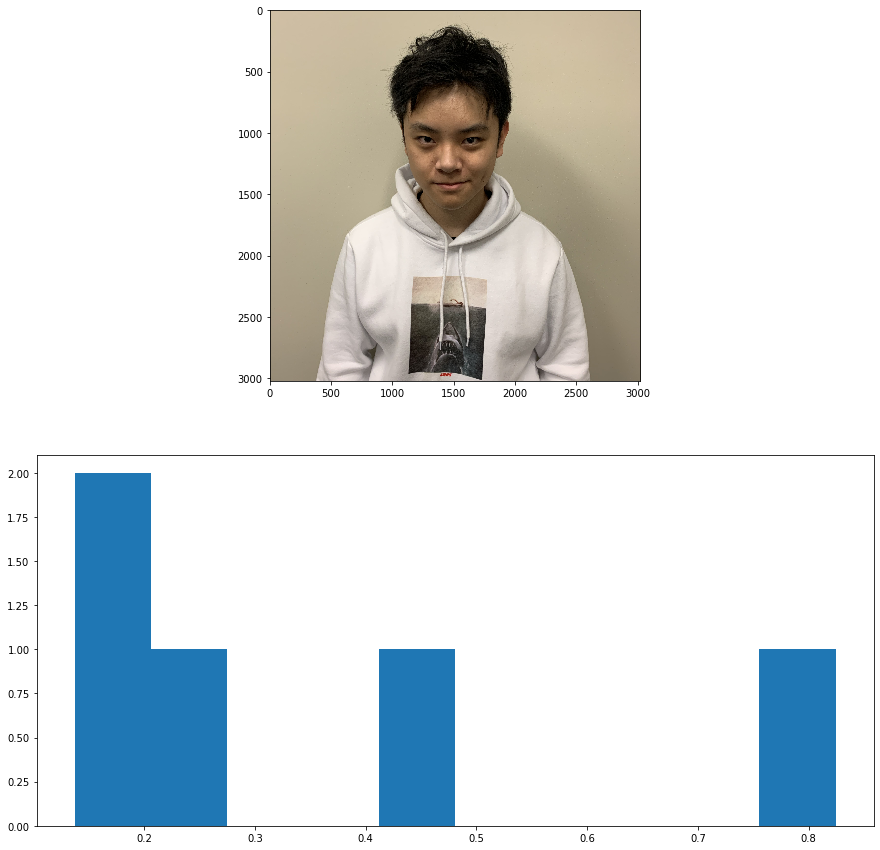

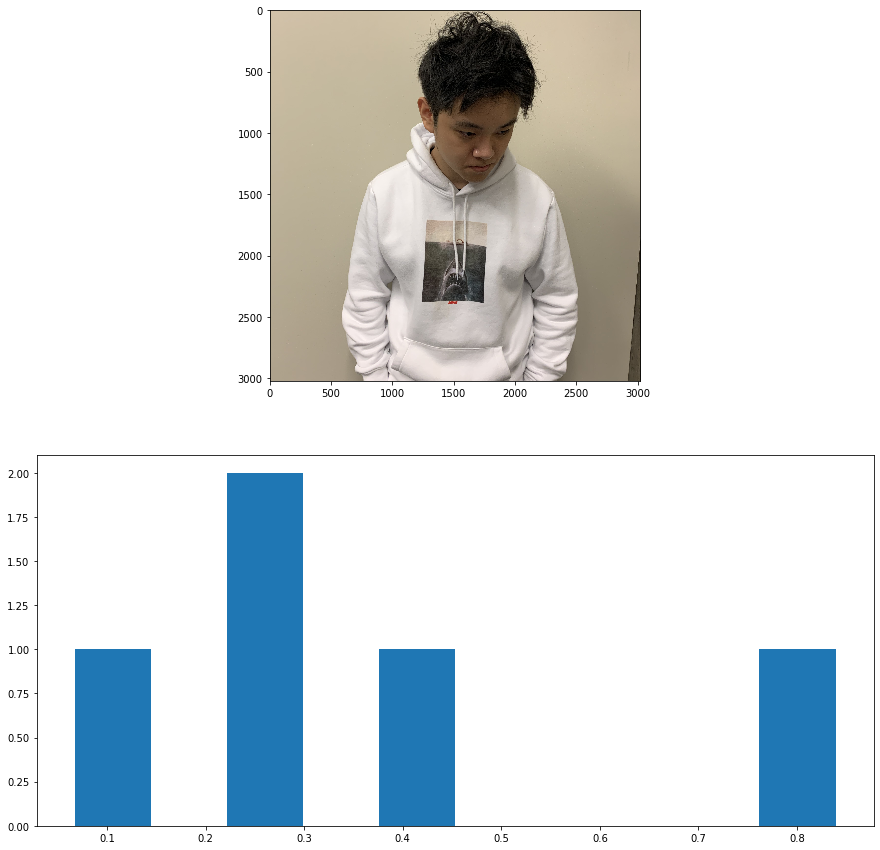

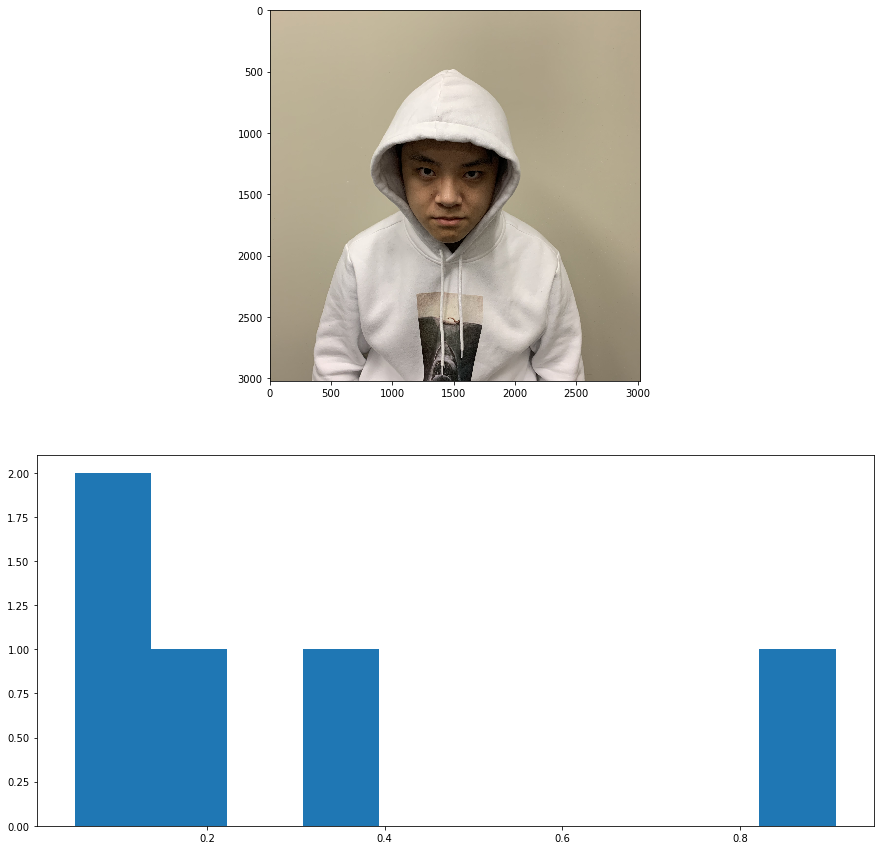

In [8]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test3 = list()
eg_test3 = list()
test_label3 = list()
i3 = 0
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: hog_compute(im, (3, 3), (2, 2), 9), sf=1.1, max_size=1000)
        bag_test3.append(encode_one(kpx, clf3))
        eg_test3.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label3.append(name_dict[people])
        if people == 'Yuxiang' and i3 < 3:
            plt.figure(figsize=(15, 15))
            plt.subplot(211)
            plt.imshow(cv2.cvtColor(cv2.imread(os.path.join(os.path.join("Testing_Images ", people), img)), 
                                    cv2.COLOR_RGB2BGR))
            plt.subplot(212)
            plt.hist(bag_test3[-1])
            plt.show()
            i3 += 1

In [9]:
clfnb3 = KNeighborsClassifier(n_neighbors=1)
clfnb3.fit(hist_train3, train_label3)
bag_pred3 = clfnb3.predict(bag_test3)
accs3 = metrics.accuracy_score(test_label3, bag_pred3)
mat3 = metrics.confusion_matrix(test_label3, bag_pred3)
print(accs3)

0.38571428571428573


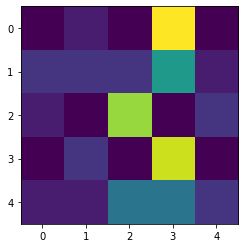

In [10]:
plt.figure()
plt.imshow(metrics.confusion_matrix(test_label3, bag_pred3))
plt.show()

# 4.3a 4x4

In [11]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag4 = list()
train_bow4 = list()
train_eg4 = list()
train_label4 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):  
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: hog_compute(im, (4, 4), (2, 2), 9))
        bag4 += sifts
        train_bow4.append(sifts)
        train_eg4.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label4.append(name_dict[people])

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [12]:
clf4 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf4.fit(np.array(bag4))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [14]:
hist_train4 = list()
for sample in train_bow4:
    hist_train4.append(encode_one(sample, clf4))

In [15]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test4 = list()
eg_test4 = list()
test_label4 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: hog_compute(im, (4, 4), (2, 2), 9), sf=1.1, max_size=1000)
        bag_test4.append(encode_one(kpx, clf4))
        eg_test4.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label4.append(name_dict[people])

In [16]:
clfnb4 = KNeighborsClassifier(n_neighbors=1)
clfnb4.fit(hist_train4, train_label4)
bag_pred4 = clfnb4.predict(bag_test4)
accs4 = metrics.accuracy_score(test_label4, bag_pred4)
mat4 = metrics.confusion_matrix(test_label4, bag_pred4)
print(accs4)

0.34285714285714286


In [17]:
print(bag_pred4)

[2 2 4 4 2 2 2 4 4 2 1 4 4 4 3 4 1 4 1 3 3 0 2 0 1 3 3 0 1 0 3 4 1 1 1 3 1
 2 0 0 0 0 3 1 1 1 3 3 3 0 1 3 3 3 3 3 3 3 3 1 3 3 1 3 3 0 3 0 3 3]


# 4.3a 5x5

In [18]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag5 = list()
train_bow5 = list()
train_eg5 = list()
train_label5 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: hog_compute(im, (5, 5), (2, 2), 9))
        bag5 += sifts
        train_bow5.append(sifts)
        train_eg5.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label5.append(name_dict[people])

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [19]:
clf5 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf5.fit(np.array(bag5))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [21]:
hist_train5 = list()
for sample in train_bow5:
    hist_train5.append(encode_one(sample, clf5))

In [22]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test5 = list()
eg_test5 = list()
test_label5 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: hog_compute(im, (5, 5), (2, 2), 9), sf=1.1, max_size=1000)
        bag_test5.append(encode_one(kpx, clf5))
        eg_test5.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label5.append(name_dict[people])

In [23]:
clfnb5 = KNeighborsClassifier(n_neighbors=1)
clfnb5.fit(hist_train5, train_label5)
bag_pred5 = clfnb5.predict(bag_test5)
accs5 = metrics.accuracy_score(test_label5, bag_pred5)
mat5 = metrics.confusion_matrix(test_label5, bag_pred5)
print(accs5)

0.34285714285714286


In [24]:
print(bag_pred5)

[2 2 4 4 2 2 2 4 4 2 1 2 4 2 2 4 1 2 1 1 4 3 2 3 3 3 4 3 2 3 3 4 4 0 3 3 4
 4 1 0 3 0 4 0 1 3 3 3 3 3 3 3 3 3 1 3 3 3 3 1 3 1 3 3 0 0 3 1 4 3]


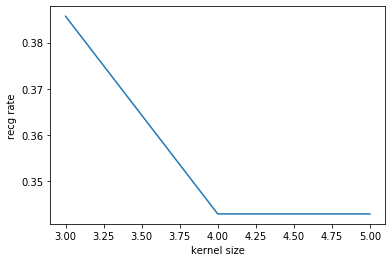

In [25]:
xksize = [3, 4, 5]
yrate = [accs3, accs4, accs5]
plt.figure()
plt.plot(xksize, yrate)
plt.ylabel("recg rate")
plt.xlabel("kernel size")
plt.show()

# 4.3b LBP 2

In [26]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag2 = list()
train_bow2 = list()
train_eg2 = list()
train_label2 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: compute_lbp(im, 2))
        bag2 += sifts
        train_bow2.append(sifts)
        train_eg2.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label2.append(name_dict[people])

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [27]:
clf2 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf2.fit(np.array(bag2))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [29]:
hist_train2 = list()
for sample in train_bow2:
    hist_train2.append(encode_one(sample, clf2))

In [30]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test2 = list()
eg_test2 = list()
test_label2 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 2), sf=1.1, max_size=1000)
        bag_test2.append(encode_one(kpx, clf2))
        eg_test2.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label2.append(name_dict[people])

In [31]:
clfnb2 = KNeighborsClassifier(n_neighbors=1)
clfnb2.fit(hist_train2, train_label2)
bag_pred2 = clfnb2.predict(bag_test2)
accs2 = metrics.accuracy_score(test_label2, bag_pred2)
mat2 = metrics.confusion_matrix(test_label2, bag_pred2)
print(accs2)

0.35714285714285715


In [32]:
print(bag_pred2)

[2 2 2 2 4 2 2 4 2 2 4 4 2 0 4 4 4 2 0 1 4 4 1 1 1 1 3 4 1 1 3 0 0 1 4 1 1
 2 4 1 3 4 4 1 4 1 3 1 1 1 1 1 3 3 1 1 3 3 1 3 3 3 1 1 3 4 1 0 1 1]


# 4.3b 7

In [33]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag7 = list()
train_bow7 = list()
train_eg7 = list()
train_label7 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: compute_lbp(im, 7))
        bag7 += sifts
        train_bow7.append(sifts)
        train_eg7.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label7.append(name_dict[people])                                                                    

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [34]:
clf7 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf7.fit(np.array(bag7))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [36]:
hist_train7 = list()
for sample in train_bow7:
    hist_train7.append(encode_one(sample, clf7))

In [37]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test7 = list()
eg_test7 = list()
test_label7 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 7), sf=1.1, max_size=1000)
        bag_test7.append(encode_one(kpx, clf7))
        eg_test7.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label7.append(name_dict[people])

In [38]:
clfnb7 = KNeighborsClassifier(n_neighbors=1)
clfnb7.fit(hist_train7, train_label7)
bag_pred7 = clfnb7.predict(bag_test7)
accs7 = metrics.accuracy_score(test_label7, bag_pred7)
mat7 = metrics.confusion_matrix(test_label7, bag_pred7)
print(accs7)

0.4142857142857143


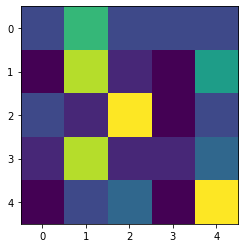

In [39]:
plt.figure()
plt.imshow(metrics.confusion_matrix(test_label7, bag_pred7))
plt.show()

# 4.3b 12

In [40]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag12 = list()
train_bow12 = list()
train_eg12 = list()
train_label12 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: compute_lbp(im, 12))
        bag12 += sifts
        train_bow12.append(sifts)
        train_eg12.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label12.append(name_dict[people])                                                                    

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [41]:
clf12 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf12.fit(np.array(bag12))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [43]:
hist_train12 = list()
for sample in train_bow12:
    hist_train12.append(encode_one(sample, clf12))

In [44]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test12 = list()
eg_test12 = list()
test_label12 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 12), sf=1.1, max_size=1000)
        bag_test12.append(encode_one(kpx, clf12))
        eg_test12.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label12.append(name_dict[people])

In [45]:
clfnb12 = KNeighborsClassifier(n_neighbors=1)
clfnb12.fit(hist_train12, train_label12)
bag_pred12 = clfnb12.predict(bag_test12)
accs12 = metrics.accuracy_score(test_label12, bag_pred12)
mat12 = metrics.confusion_matrix(test_label12, bag_pred12)
print(accs12)

0.4142857142857143


In [46]:
print(bag_pred12)

[0 2 1 2 2 3 2 2 2 2 1 0 2 2 2 2 2 2 2 4 1 4 2 0 1 1 1 1 1 1 1 2 1 1 1 1 1
 1 2 1 1 2 2 4 1 3 1 3 1 4 3 3 1 3 1 1 3 4 4 1 3 1 4 1 3 0 1 0 4 1]


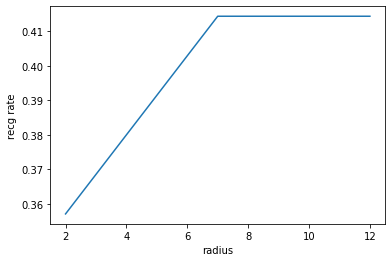

In [47]:
xksize = [2, 7, 12]
yrate = [accs2, accs7, accs12]
plt.figure()
plt.plot(xksize, yrate)
plt.ylabel("recg rate")
plt.xlabel("radius")
plt.show()

Reason: 
<br>
LBP value calculated for this center pixel and stored in the output 2D array with the same width and height as the input image. LBP labels the pixels of an image by thresholding the neighborhood of each pixel and considers the result as a binary number. Therefore, the LBP codes can also provide responses salient shapes, which means to monotonically changing intensity functions and edges within the image microstructure. However, for Hog algorithm, we counts occurrences of gradient orientation in localized portions of an image. To conclude, The LBP algorithm has the better contraction and better performance.

# 5

In [48]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag75 = list()
train_bow75 = list()
train_eg75 = list()
train_label75 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 5,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: compute_lbp(im, 7))
        bag75 += sifts
        train_bow75.append(sifts)
        train_eg75.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label75.append(name_dict[people])     

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [49]:
clf75 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf75.fit(np.array(bag75))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [51]:
hist_train75 = list()
for sample in train_bow75:
    hist_train75.append(encode_one(sample, clf75))

In [52]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test75 = list()
eg_test75 = list()
test_label75 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 5,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 7), sf=1.1, max_size=1000)
        bag_test75.append(encode_one(kpx, clf75))
        eg_test75.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label75.append(name_dict[people])

In [53]:
clfnb75 = KNeighborsClassifier(n_neighbors=1)
clfnb75.fit(hist_train75, train_label75)
bag_pred75 = clfnb75.predict(bag_test75)
accs75 = metrics.accuracy_score(test_label75, bag_pred75)
mat75 = metrics.confusion_matrix(test_label75, bag_pred75)
print(accs75)

0.34285714285714286


In [54]:
print(bag_pred75)

[2 1 1 2 2 2 2 1 1 2 2 1 2 2 4 0 4 4 2 1 2 2 1 2 2 2 4 2 1 3 1 2 1 0 2 2 2
 2 1 2 2 1 2 2 1 1 4 2 1 1 0 3 2 2 0 2 0 2 4 4 0 1 0 0 0 1 1 3 4 2]


# 15: Included in LBP radius=7

# 25

In [55]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag725 = list()
train_bow725 = list()
train_eg725 = list()
train_label725 = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 25,
                            lambda imx: keypoints_sift(imx, sift), 
                            lambda im: compute_lbp(im, 7))
        bag725 += sifts
        train_bow725.append(sifts)
        train_eg725.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label725.append(name_dict[people])   

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [56]:
clf725 = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf725.fit(np.array(bag725))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [58]:
hist_train725 = list()
for sample in train_bow725:
    hist_train725.append(encode_one(sample, clf725))

In [59]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test725 = list()
eg_test725 = list()
test_label725 = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 25,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 7), sf=1.1, max_size=1000)
        bag_test725.append(encode_one(kpx, clf725))
        eg_test725.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label725.append(name_dict[people])

In [60]:
clfnb725 = KNeighborsClassifier(n_neighbors=1)
clfnb725.fit(hist_train725, train_label725)
bag_pred725 = clfnb725.predict(bag_test725)
accs725 = metrics.accuracy_score(test_label725, bag_pred725)
mat725 = metrics.confusion_matrix(test_label725, bag_pred725)
print(accs725)

0.2857142857142857


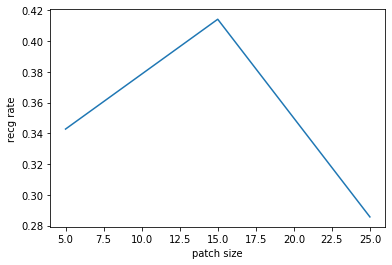

In [61]:
xksize = [5, 15, 25]
yrate = [accs75, accs7, accs725]
plt.figure()
plt.plot(xksize, yrate)
plt.ylabel("recg rate")
plt.xlabel("patch size")
plt.show()

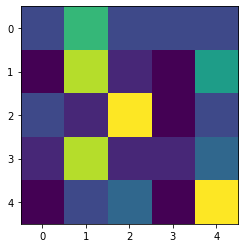

In [62]:
plt.figure()
plt.imshow(metrics.confusion_matrix(test_label7, bag_pred7))
plt.show()

# Harris

In [63]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
name_dict = {'Yuxiang': 0, 'Sherry': 1, 'Fandi': 2, 'Tingzhe': 3, 'Menghan': 4}

bag7h = list()
train_bow7h = list()
train_eg7h = list()
train_label7h = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    for img in os.listdir(os.path.join("Training_Images", people)):    
        if img in {'.DS_Store'}:
            continue
        # print(img)
        sifts = compute_one(os.path.join(os.path.join("Training_Images", people), img), fclf, 15,
                            lambda imx: keypoints_harris(imx, 0.01), lambda im: compute_lbp(im, 7))
        bag7h += sifts
        train_bow7h.append(sifts)
        train_eg7h.append(compute_eigen(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
        train_label7h.append(name_dict[people])  

People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [64]:
clf7h = mixture.GaussianMixture(n_components=5, covariance_type='full')
clf7h.fit(np.array(bag7h))

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=5, n_init=1, precisions_init=None,
                random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
                verbose_interval=10, warm_start=False, weights_init=None)

In [66]:
hist_train7h = list()
for sample in train_bow7h:
    hist_train7h.append(encode_one(sample, clf7h))

In [67]:
fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
sift = cv2.xfeatures2d.SIFT_create()
bag_test7h = list()
eg_test7h = list()
test_label7h = list()
for people in os.listdir("Testing_Images "):
    print("People: " + people, end=', ')
    if people not in name_dict:
        continue
    for img in os.listdir(os.path.join("Testing_Images ", people)):
        print("Img: " + img, end='\r')
        kpx = compute_one(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 15,
                          lambda imx: keypoints_sift(imx, sift), 
                          lambda im: compute_lbp(im, 7), sf=1.1, max_size=1000)
        bag_test7h.append(encode_one(kpx, clf7h))
        eg_test7h.append(compute_eigen(os.path.join(os.path.join("Testing_Images ", people), img), fclf, 128))
        test_label7h.append(name_dict[people])

In [68]:
clfnb7h = KNeighborsClassifier(n_neighbors=1)
clfnb7h.fit(hist_train7h, train_label7h)
bag_pred7h = clfnb7h.predict(bag_test7h)
accs7h = metrics.accuracy_score(test_label7h, bag_pred7h)
mat7h = metrics.confusion_matrix(test_label7h, bag_pred7h)
print(accs7h)

0.2


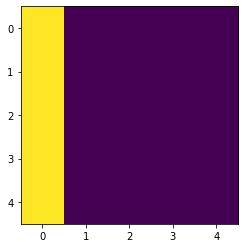

In [69]:
plt.figure()
plt.imshow(metrics.confusion_matrix(test_label7h, bag_pred7h))
plt.show()

# PCA

In [70]:
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsClassifier
accs = [0]
for i in range(1, 60):
    pca = PCA(n_components=i)
    pca.fit(np.array(train_eg7))
    eg_transf = pca.transform(np.array(train_eg7))
    eg_test_transf = pca.transform(eg_test7)
    neigh = KNeighborsClassifier(n_neighbors=1)
    neigh.fit(eg_transf, train_label7)
    y_pred = neigh.predict(eg_test_transf)
    accs.append(metrics.accuracy_score(y_pred, test_label7))

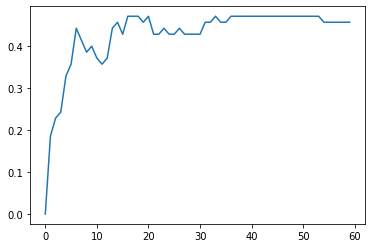

In [71]:
plt.figure()
plt.plot([x for x in range(60)], accs)

In [73]:
pca = PCA(n_components=40)
pca.fit(np.array(train_eg7))
eg_transf = pca.transform(np.array(train_eg7))
eg_test_transf = pca.transform(eg_test7)
neigh = KNeighborsClassifier(n_neighbors=1)
neigh.fit(eg_transf, train_label7)
y_pred = neigh.predict(eg_test_transf)
print(metrics.accuracy_score(y_pred, test_label7))

0.4714285714285714


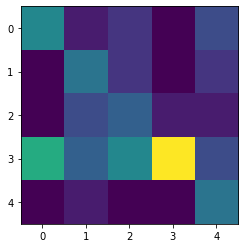

In [74]:
plt.figure()
plt.imshow(metrics.confusion_matrix(y_pred, test_label7))
plt.show()

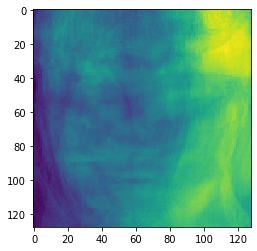

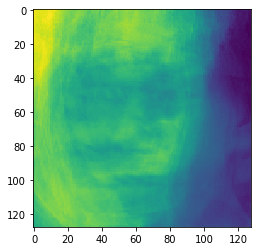

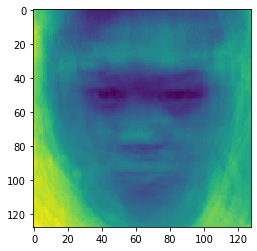

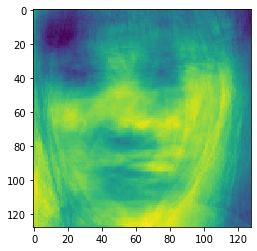

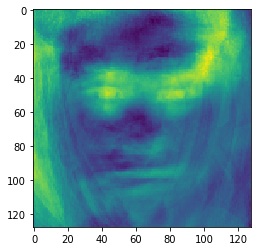

In [75]:
for i in range(5):
    plt.figure()
    plt.imshow(pca.components_[i].reshape((128, 128)))
    plt.show()

### Q:Evaluate the method using recognition rate and confusion matrix. Compare the PCA based method with best performing bag-of-words method from experiment
### A:
Application of PCA improves the accuracy of image detection to 0.471 and the confusion matrix shows a clear diagonal with high intensity, which all represents progress in face detection. Suppose using BoG model, it will parse a lot of text and those feature set becomes unmanageable, and the marginal benefit of adding another variable diminishes. While PCA is used to remove the least beneficial feature so that we have a smaller dataset, but without losing too much predictive power.
### Q: Write a combined summary/conclusion of the above four experiments (3 in Section:3 and 1 of PCA).
### A:
In summary, HOG refers the capture of bounding box fringes, while LBP prefers to color capture, and PCA refers to a specific and basic linear transformation to rebuild a dataset. We think, in the region of face detection, especially for our dataset, detecting address of intensity performs better than detecting unimportant lines and points on the face. Therefore, PCA is an optimal method for face detection, since it solves the least square problem that fits a hyperplane in the face feature space which minimizes the least square error. 



### Q: Compare the results of SIFT/SURF (from experiment 2) and Harris corners.
### A:
It has the recognition rate of  0.2 and confusion matrix of harris as below. By comparing the results of SIFT/SURF and Harris, the average performance of all SIFT/SURF(problem 3.3.2) is better than that of Harris in terms of their recognition rate. 

# Group Photo

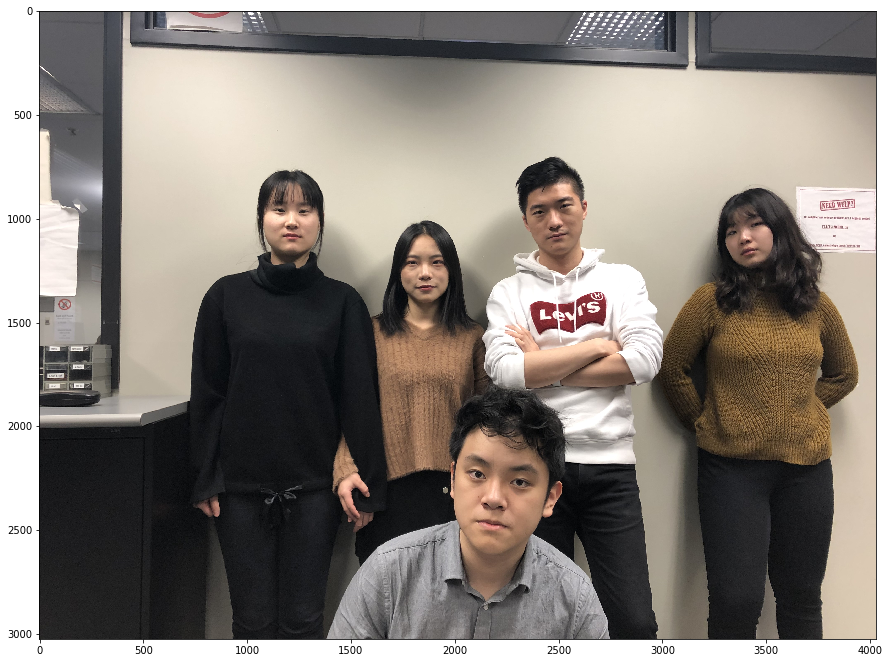

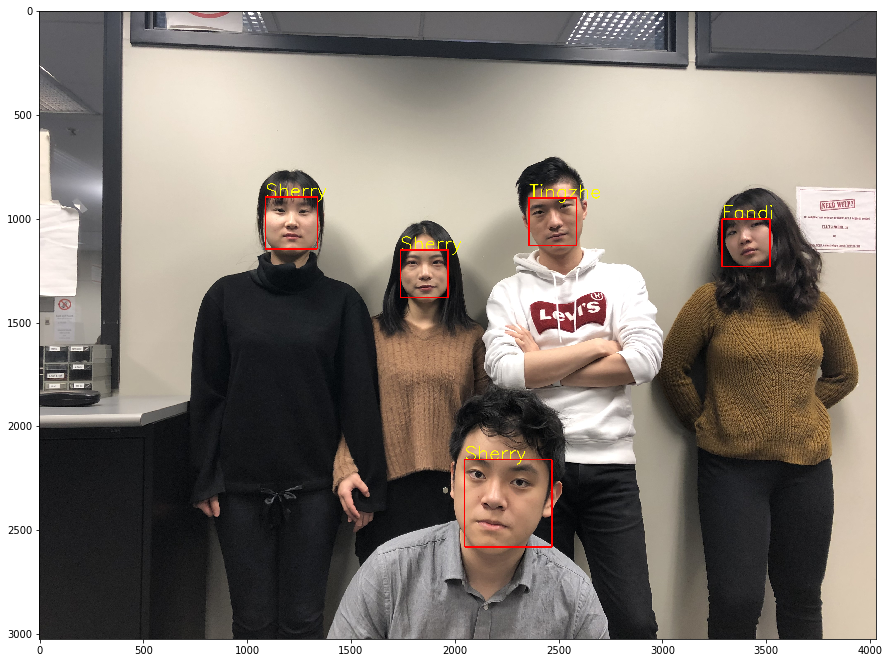

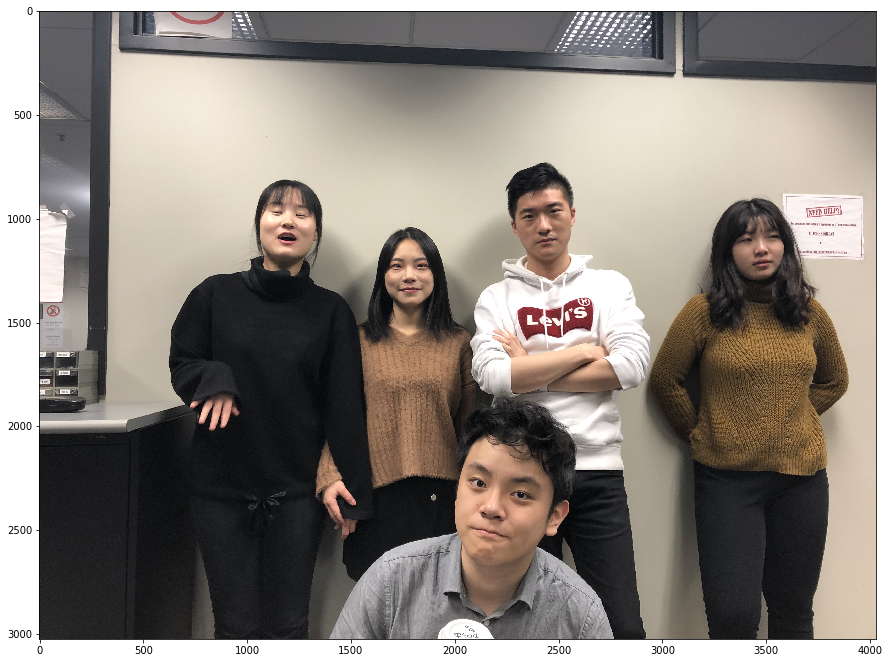

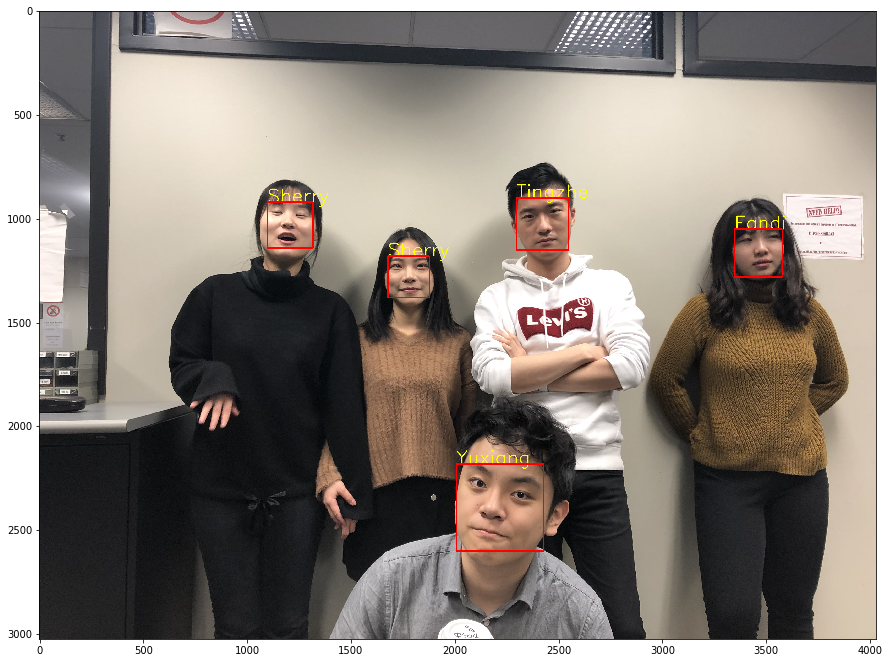

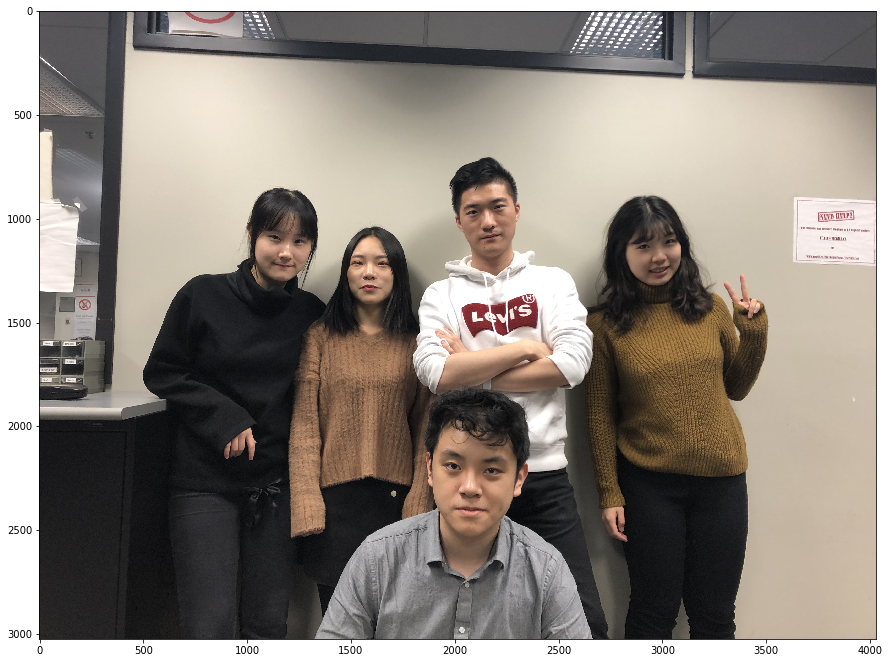

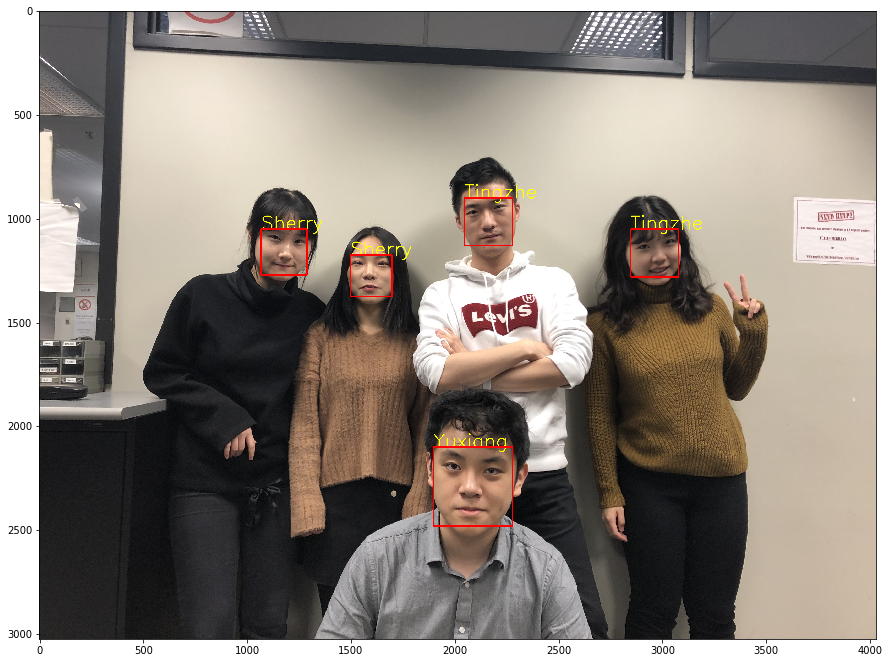

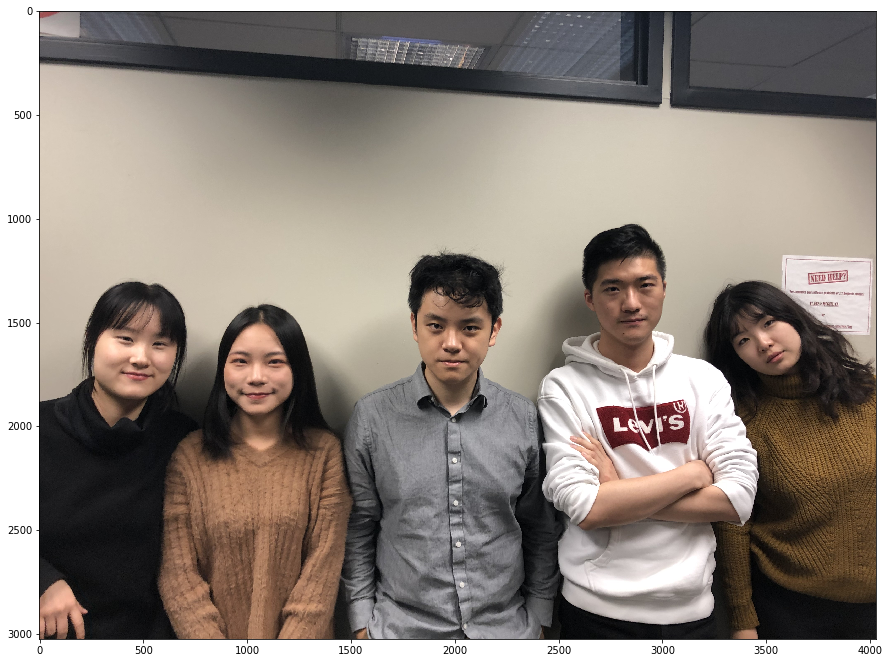

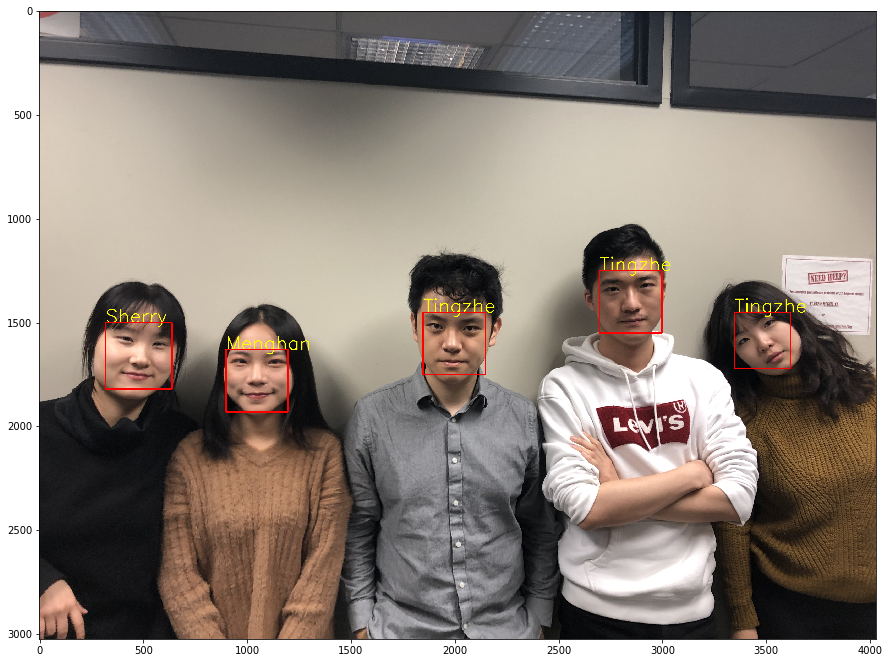

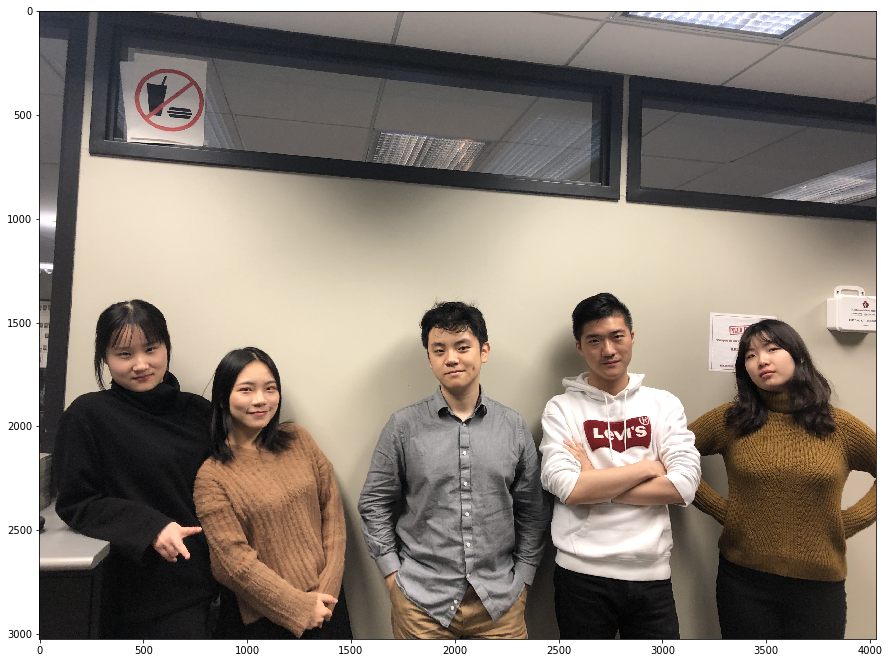

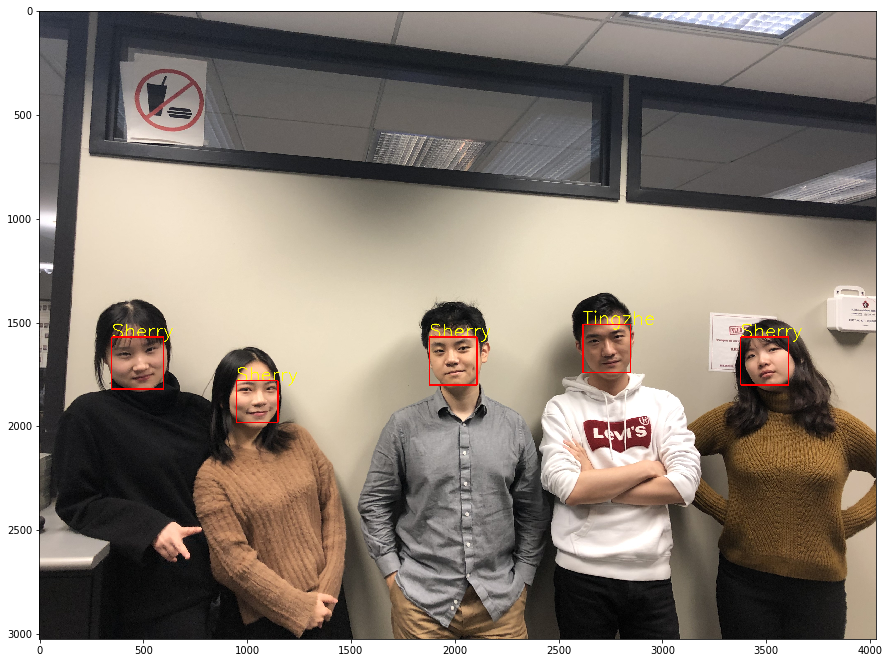

In [76]:
id_name = ['Fandi', 'Menghan', 'Tingzhe', 'Sherry', 'Yuxiang']
dict_name = ['Yuxiang', 'Sherry', 'Fandi', 'Tingzhe', 'Menghan']
dg = {"group_photos/gp0.jpeg": [(1090, 895, 250, 250), (1740, 1150, 230, 230), (2360, 900, 230, 230), 
                                (3290, 1000, 230, 230), (2050, 2160, 420, 420)], 
      "group_photos/gp1.jpeg": [(1100, 920, 220, 220), (1680, 1180, 200, 200), 
                                (2300, 900, 250, 250), (3350, 1050, 230, 230), (2010, 2180, 420, 420)], 
      "group_photos/gp2.jpeg": [(1070, 1050, 220, 220), (1500, 1175, 200, 200), 
                                (2050, 900, 230, 230), (2850, 1050, 230, 230), (1900, 2100, 380, 380)], 
      "group_photos/gp3.jpeg": [(320, 1500, 320, 320), (900, 1630, 300, 300), 
                                (2700, 1250, 300, 300), (3350, 1450, 270, 270), (1850, 1450, 300, 300)], 
      "group_photos/gp4.jpeg": [(350, 1570, 250, 250), (950, 1780, 200, 200), 
                                (2620, 1510, 230, 230), (3380, 1570, 230, 230), (1880, 1570, 230, 230)]
      }
for imgid in range(5):
    img_tst_ = cv2.cvtColor(cv2.imread("group_photos/gp" + str(imgid) + ".jpeg"), cv2.COLOR_RGB2BGR)
    plt.figure(figsize=(15, 15))
    plt.imshow(img_tst_)
    plt.show()
    img_tst_2 = cv2.cvtColor(img_tst_, cv2.COLOR_BGR2GRAY)
    for (ulx, uly, dx, dy) in dg["group_photos/gp" + str(imgid) + ".jpeg"]:
        pcv = pca.transform([cv2.resize(img_tst_2[uly:uly + dy, ulx:ulx + dx], (128, 128)).flatten()])
        res = neigh.predict(pcv)
        img_tst_ = cv2.putText(img_tst_, dict_name[res[0]], (ulx, uly), cv2.FONT_HERSHEY_SIMPLEX, 
                               3, (255, 255, 0), 3, cv2.LINE_AA) 
        img_tst_ = cv2.rectangle(img_tst_, (ulx, uly), (ulx + dx, uly + dy), (255, 0, 0), 5)
    plt.figure(figsize=(15, 15))
    plt.imshow(img_tst_)
    plt.show()


# Bonus

In [77]:
import heapq

def hog_compute(img, cell_size, block_size, nbins):
    # create HoG Object
    # winSize is the size of the image cropped to multiple of the cell size
    # all arguments should be given in terms of number of pixels
    hog = cv2.HOGDescriptor(_winSize=(img.shape[1] // cell_size[1] * cell_size[1],
                            img.shape[0] // cell_size[0] * cell_size[0]),
                            _blockSize=(block_size[1] * cell_size[1],
                                        block_size[0] * cell_size[0]),
                            _blockStride=(cell_size[1], cell_size[0]),
                            _cellSize=(cell_size[1], cell_size[0]),
                            _nbins=nbins)

    n_cells = (img.shape[0] // cell_size[0], img.shape[1] // cell_size[1])

    # Compute HoG features
    hog_feats = hog.compute(img) \
                   .reshape(n_cells[1] - block_size[1] + 1,
                            n_cells[0] - block_size[0] + 1,
                            block_size[1], block_size[0], nbins) \
                   .transpose((1, 0, 3, 2, 4))  # index blocks by rows first
    return hog_feats

def hog_detect(img, clf, stride, ksize, thr):
    # heap data structure for finding k smallest
    detect_reslist = []
    # Extract overlapping windows from the test image
    for i in range(0, img.shape[0], stride):
        for j in range(0, img.shape[1], stride):
            # Overlapping window extracted
            window = img[i:i + ksize[1], j:j + ksize[0]]
            # Resize windows to 128×128 
            resized_window = cv2.resize(window, (128, 128))
            # Compute HoG features similar to what was done during training
            t_hog = hog_compute(resized_window, (4, 4), (2, 2), 9)
            # Threshold the two distances to detect cars in the test image
            dist = np.linalg.norm(t_hog - clf)
            if dist < thr:
                heapq.heappush(detect_reslist, (dist, ((i, j), window))) 
    # Display detected window
    
    for i in range(min(len(detect_reslist), 15)):
        k_smallest = heapq.heappop(detect_reslist)
        plt.figure(figsize = (5,5))
        plt.imshow(k_smallest[1][1])
        plt.show()
    

def compute_car(src: str, fclf: cv2.CascadeClassifier, imsize: int, 
                sf=1.1, max_size=850) -> List[np.ndarray]:
    img_tst_ = cv2.imread(src)
    img_tst_ = cv2.cvtColor(img_tst_, cv2.COLOR_RGB2BGR)
    img_tst = cv2.cvtColor(img_tst_, cv2.COLOR_BGR2GRAY)
    if src in dfxs:
        ulx, uly, dx, dy = dfxs[src]
    else:
        fxs = fclf.detectMultiScale(img_tst, scaleFactor=sf, maxSize=(max_size, max_size), 
                                    minSize=(300, 300))
        ulx, uly, dx, dy = fxs[0]
    return hog_compute(cv2.resize(img_tst[uly:uly + dy, ulx:ulx + dx], (imsize, imsize)), (5, 5), (2, 2), 9)

In [78]:
peoples = list()
peoples_label = list()
for people in os.listdir("Training_Images"):
    if people not in name_dict:
        continue
    print("People: " + people)
    peoples_label.append(people)
    person = list()
    for img in os.listdir(os.path.join("Training_Images", people)):     
        if img in {'.DS_Store'}:
            continue
        person.append(compute_car(os.path.join(os.path.join("Training_Images", people), img), fclf, 128))
    peoples.append(person)


People: Fandi
People: Menghan
People: Sherry
People: Tingzhe
People: Yuxiang


In [79]:
peoples_avg = [np.mean(np.array(people), axis=0) for people in peoples]

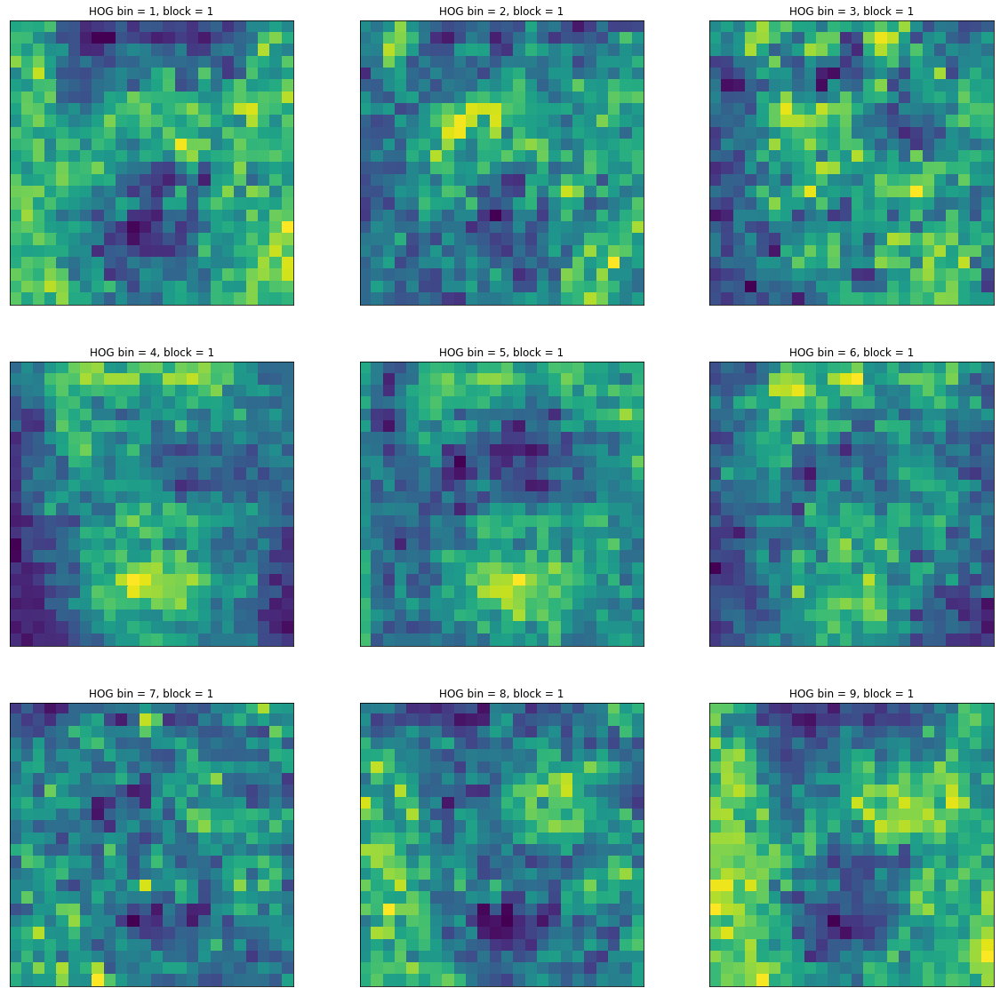

In [80]:
plt.figure(figsize = (20,20))
for i in range(9):
    plt.subplot(331 + i)
    plt.pcolor(peoples_avg[3][:, :, 0, 0, i])
    plt.gca().invert_yaxis()
    plt.gca().set_aspect('equal', adjustable='box')
    plt.title("HOG bin = " + str(i + 1) + ", block = 1"), plt.xticks([]), plt.yticks([])
plt.show()

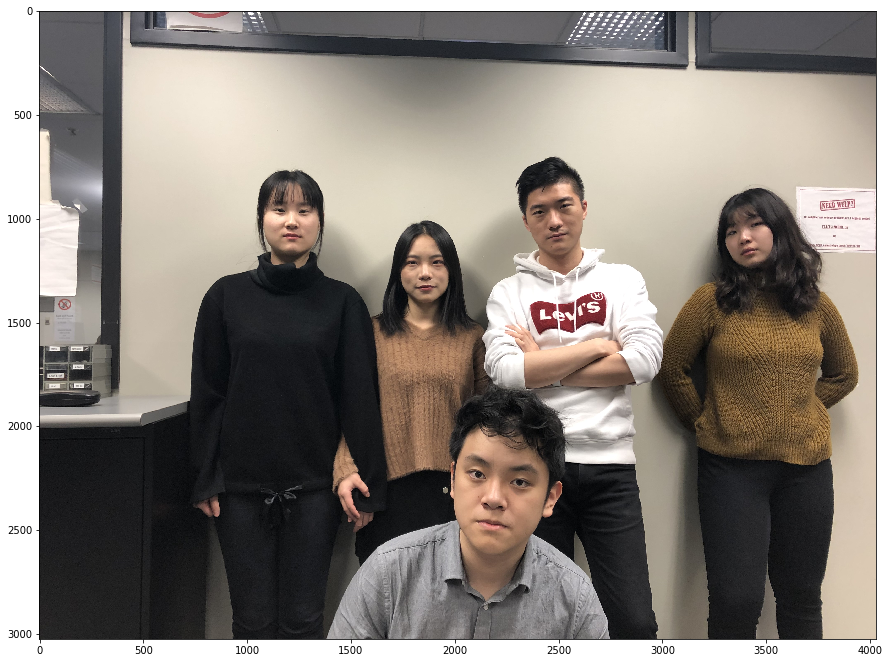

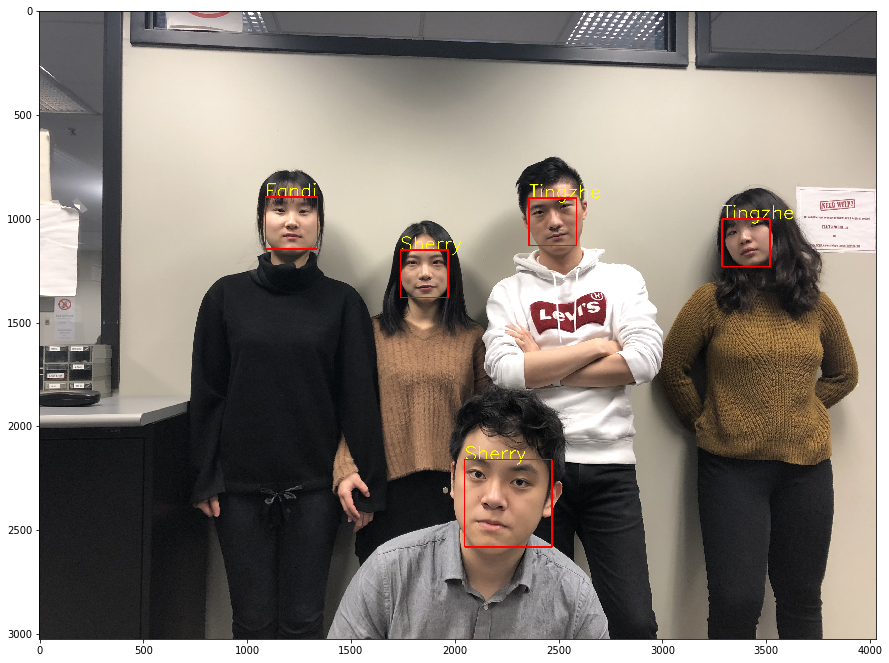

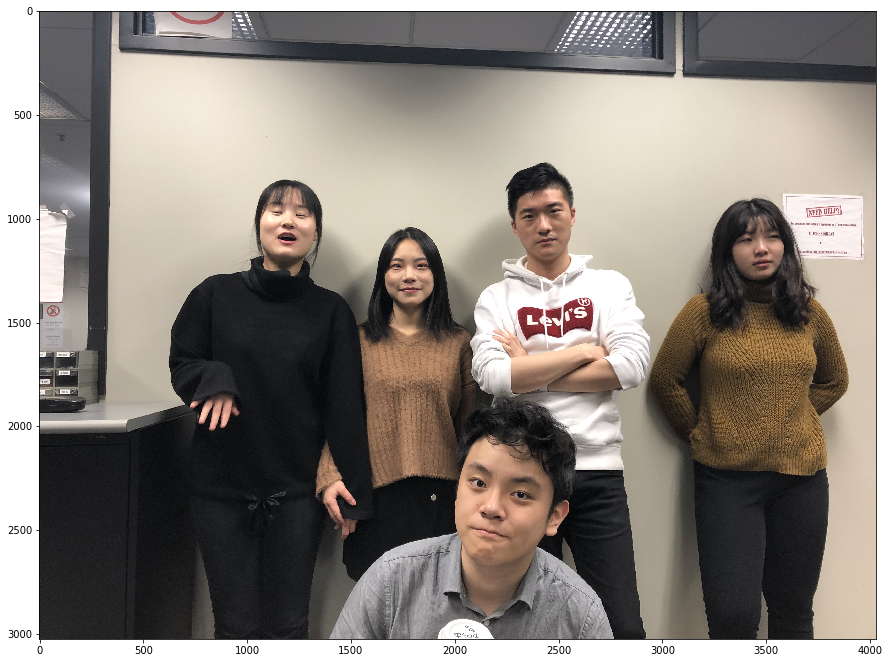

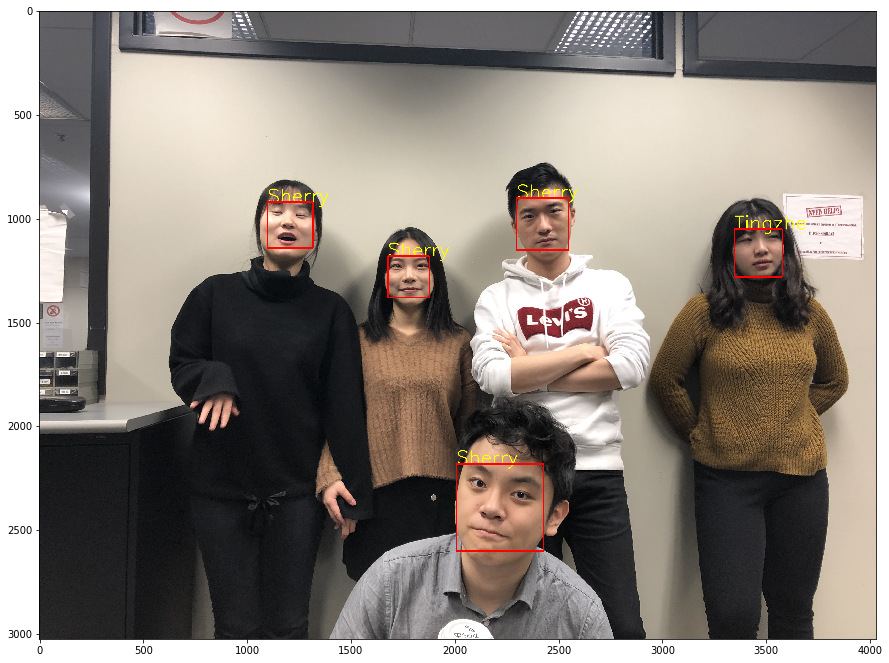

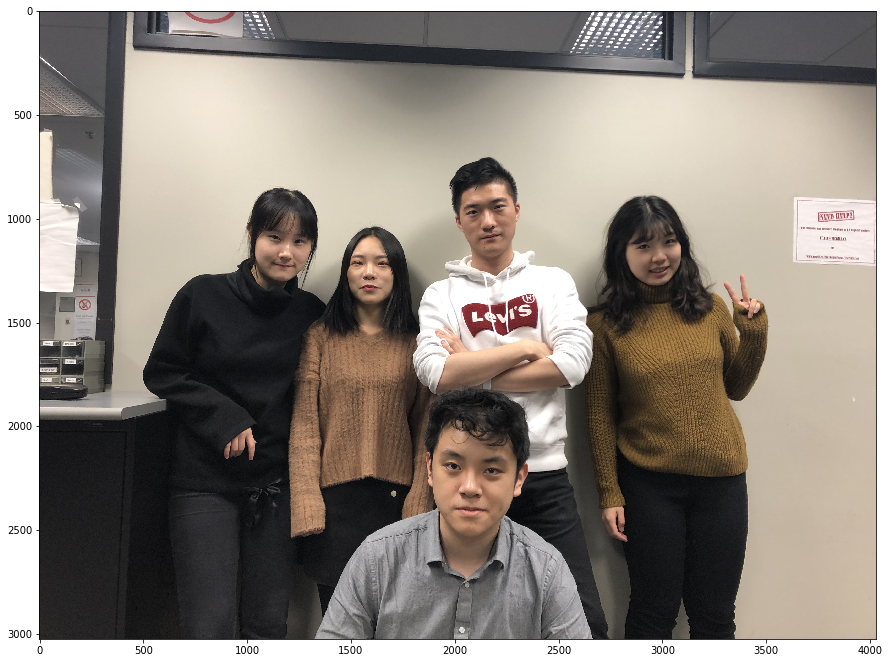

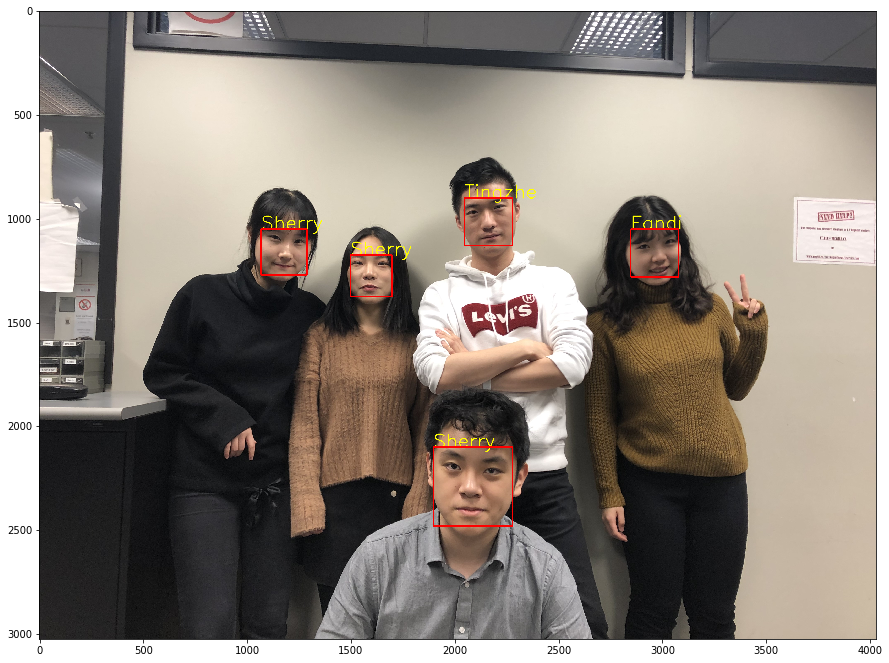

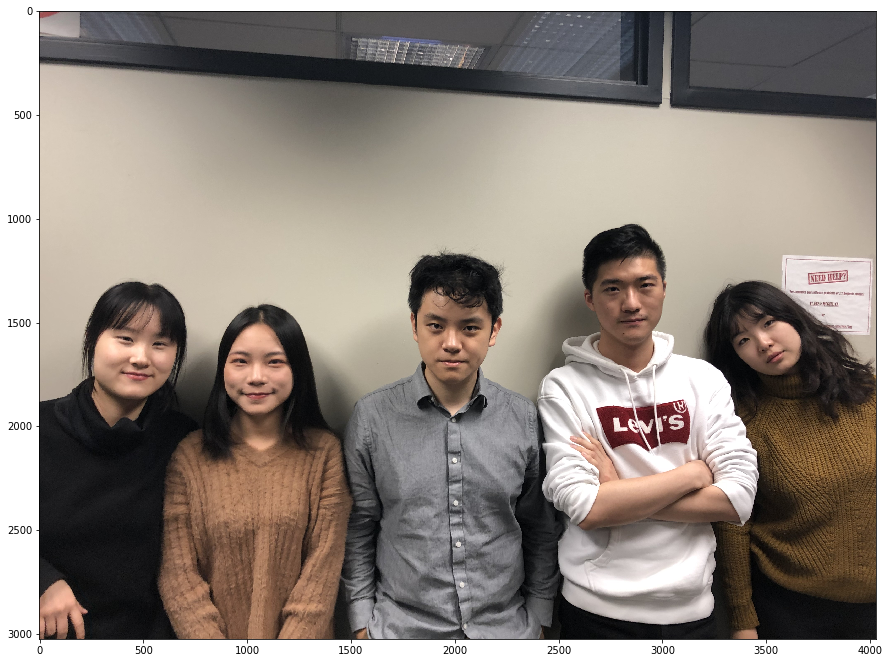

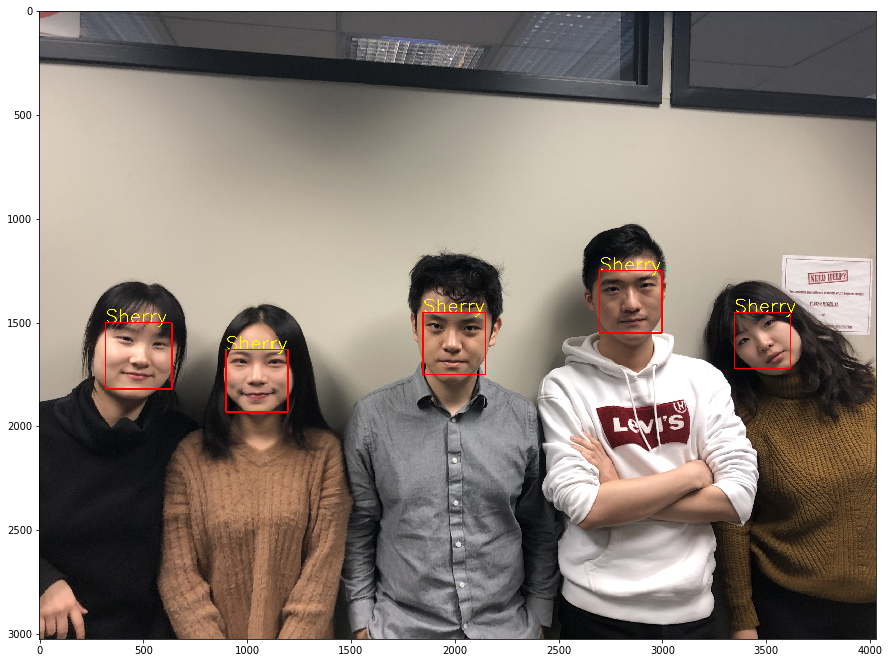

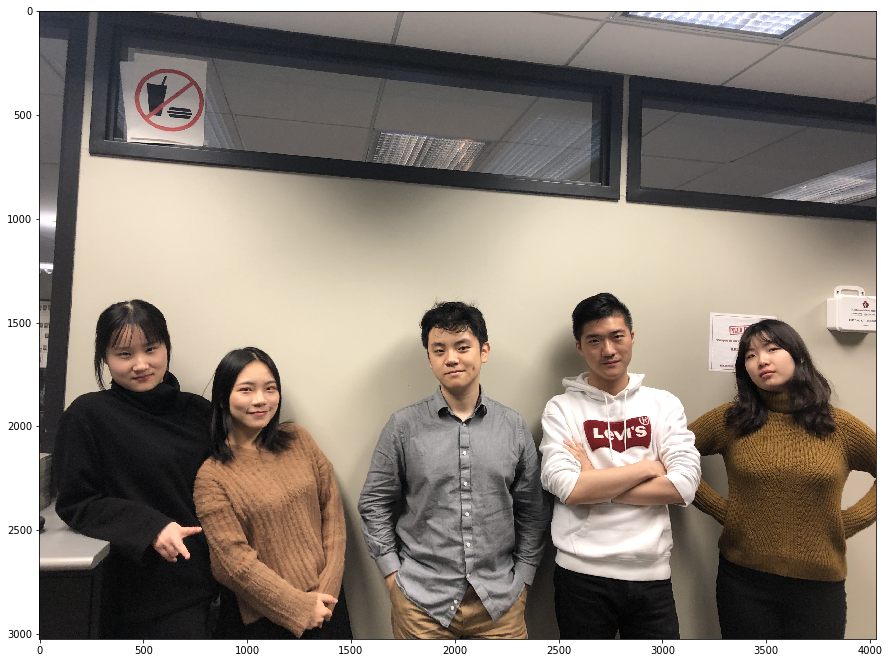

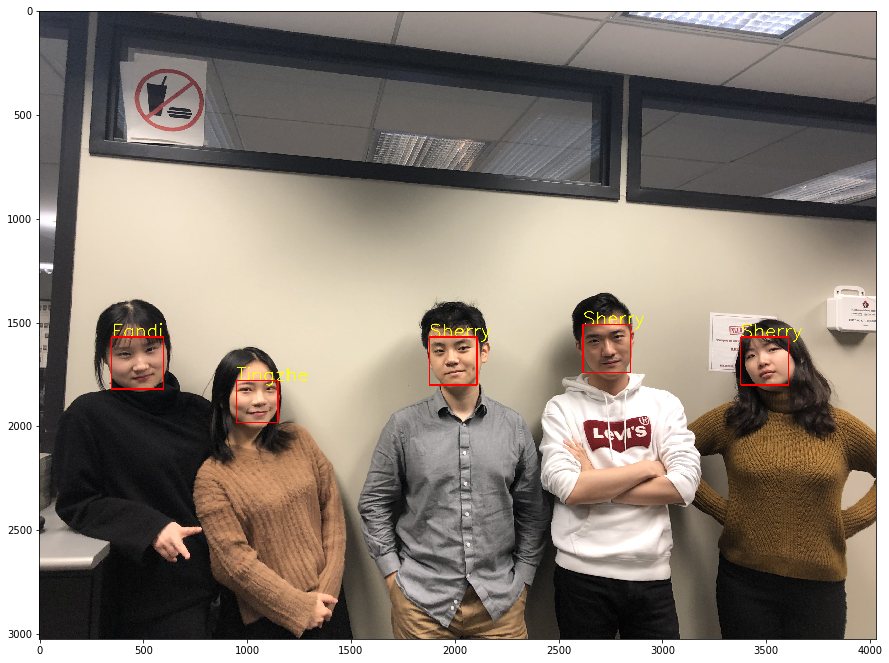

In [81]:
dg = {"group_photos/gp0.jpeg": [(1090, 895, 250, 250), (1740, 1150, 230, 230), (2360, 900, 230, 230), 
                                (3290, 1000, 230, 230), (2050, 2160, 420, 420)], 
      "group_photos/gp1.jpeg": [(1100, 920, 220, 220), (1680, 1180, 200, 200), 
                                (2300, 900, 250, 250), (3350, 1050, 230, 230), (2010, 2180, 420, 420)], 
      "group_photos/gp2.jpeg": [(1070, 1050, 220, 220), (1500, 1175, 200, 200), 
                                (2050, 900, 230, 230), (2850, 1050, 230, 230), (1900, 2100, 380, 380)], 
      "group_photos/gp3.jpeg": [(320, 1500, 320, 320), (900, 1630, 300, 300), 
                                (2700, 1250, 300, 300), (3350, 1450, 270, 270), (1850, 1450, 300, 300)], 
      "group_photos/gp4.jpeg": [(350, 1570, 250, 250), (950, 1780, 200, 200), 
                                (2620, 1510, 230, 230), (3380, 1570, 230, 230), (1880, 1570, 230, 230)]
      }
for imgid in range(5):
    img_tst_ = cv2.cvtColor(cv2.imread("group_photos/gp" + str(imgid) + ".jpeg"), cv2.COLOR_RGB2BGR)
    plt.figure(figsize=(15, 15))
    plt.imshow(img_tst_)
    plt.show()
    for (ulx, uly, dx, dy) in dg["group_photos/gp" + str(imgid) + ".jpeg"]:
        cimg = hog_compute(cv2.resize(img_tst_[uly:uly + dy, ulx:ulx + dx], (128, 128)), (5, 5), (2, 2), 9)
        res = np.argmin(np.array([np.linalg.norm(cimg - people_avg) for people_avg in peoples_avg]))
        img_tst_ = cv2.putText(img_tst_, peoples_label[res], (ulx, uly), cv2.FONT_HERSHEY_SIMPLEX, 
                               3, (255, 255, 0), 3, cv2.LINE_AA) 
        img_tst_ = cv2.rectangle(img_tst_, (ulx, uly), (ulx + dx, uly + dy), (255, 0, 0), 5)
    plt.figure(figsize=(15, 15))
    plt.imshow(img_tst_)
    plt.show()

# Display Key Points for 10 Training Images

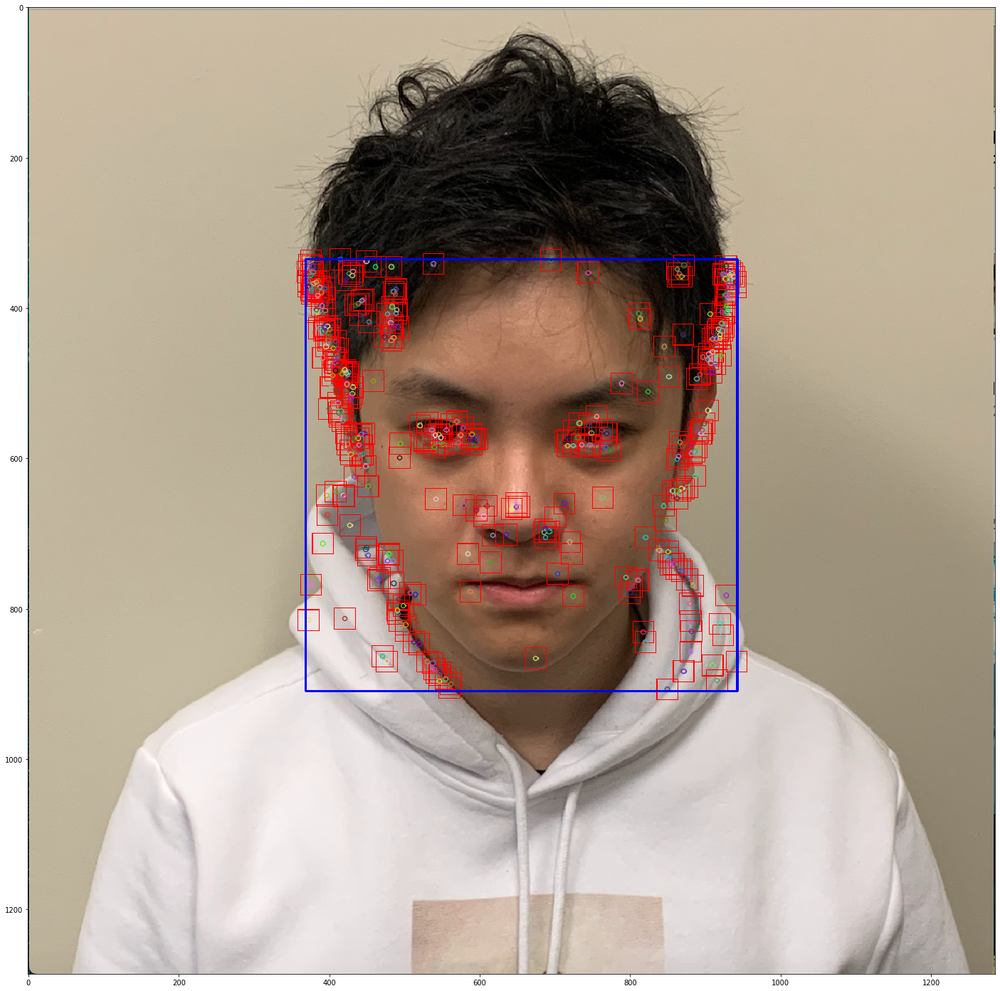

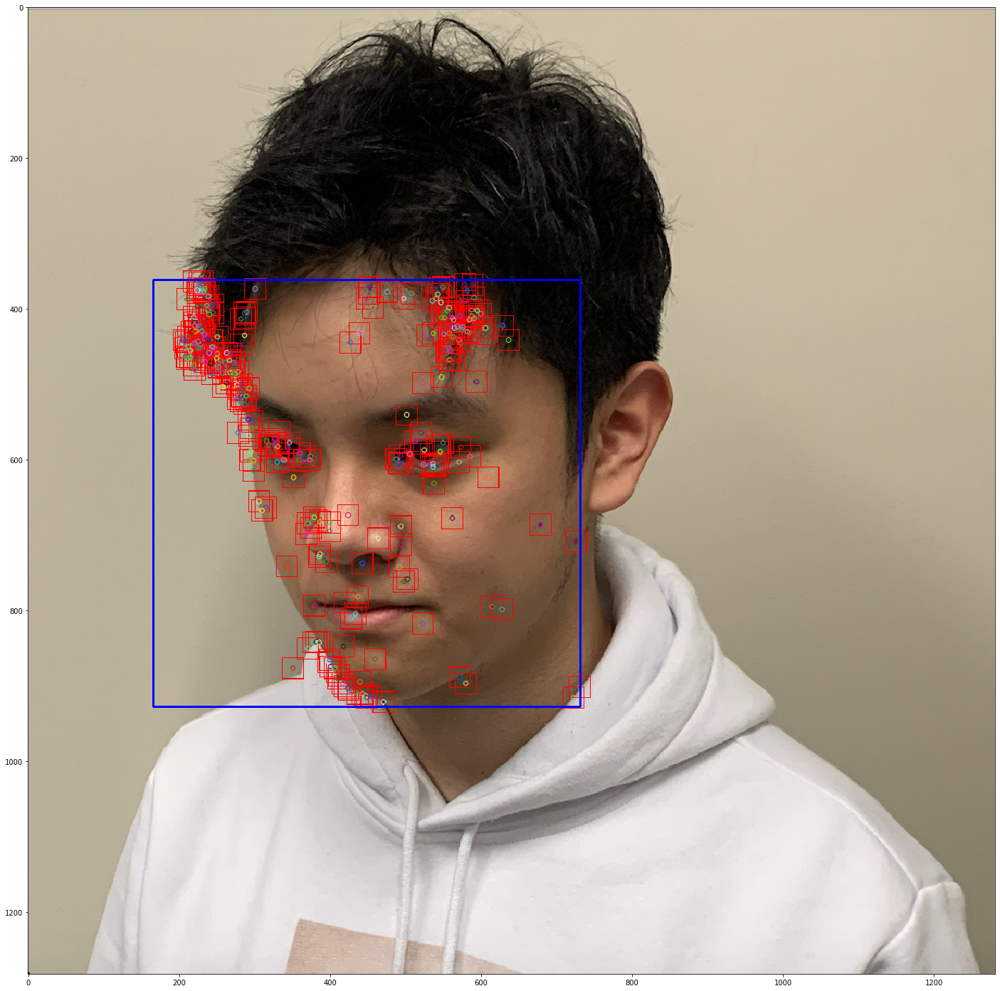

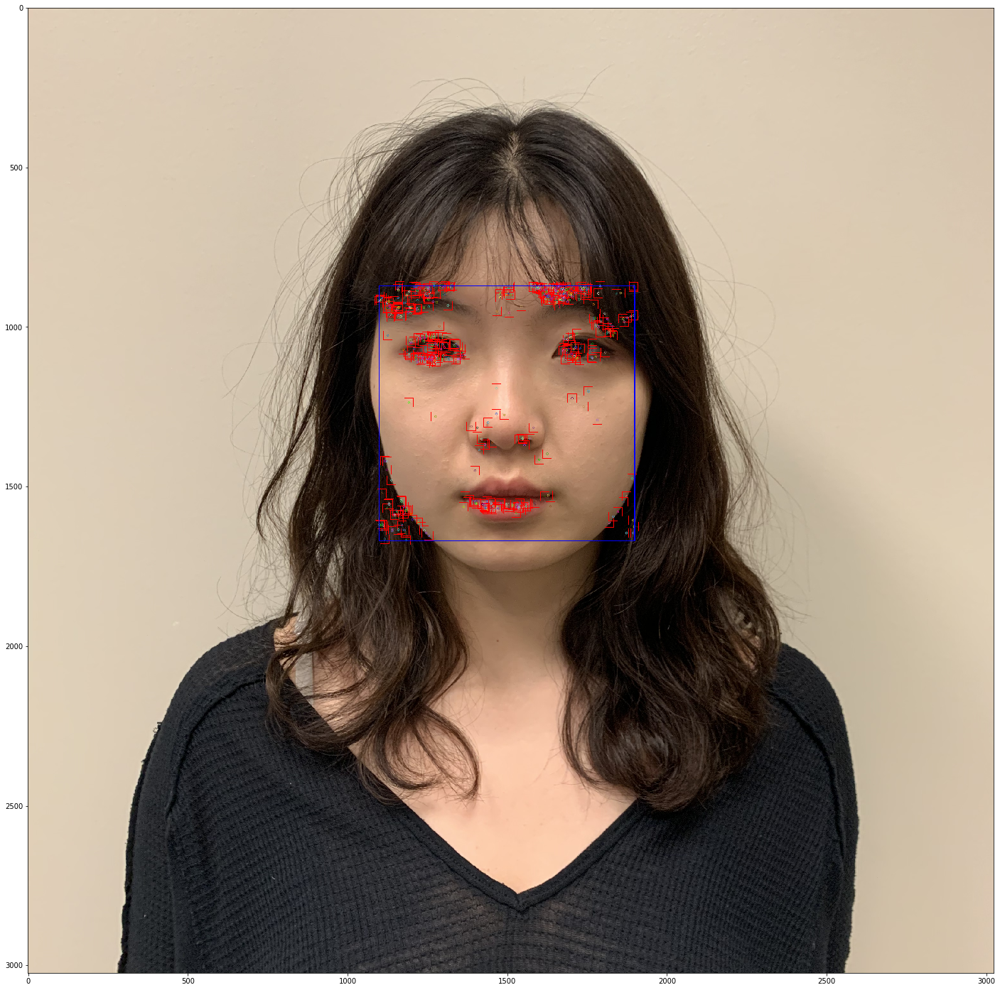

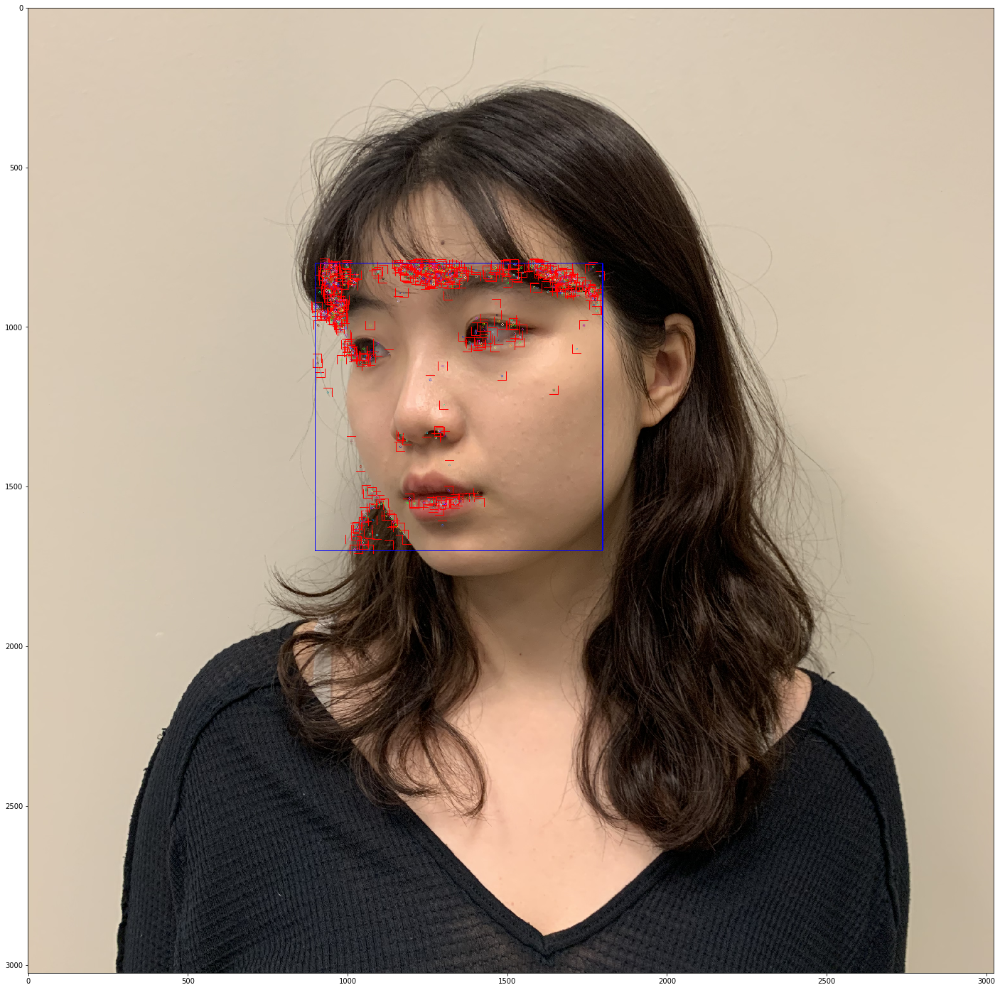

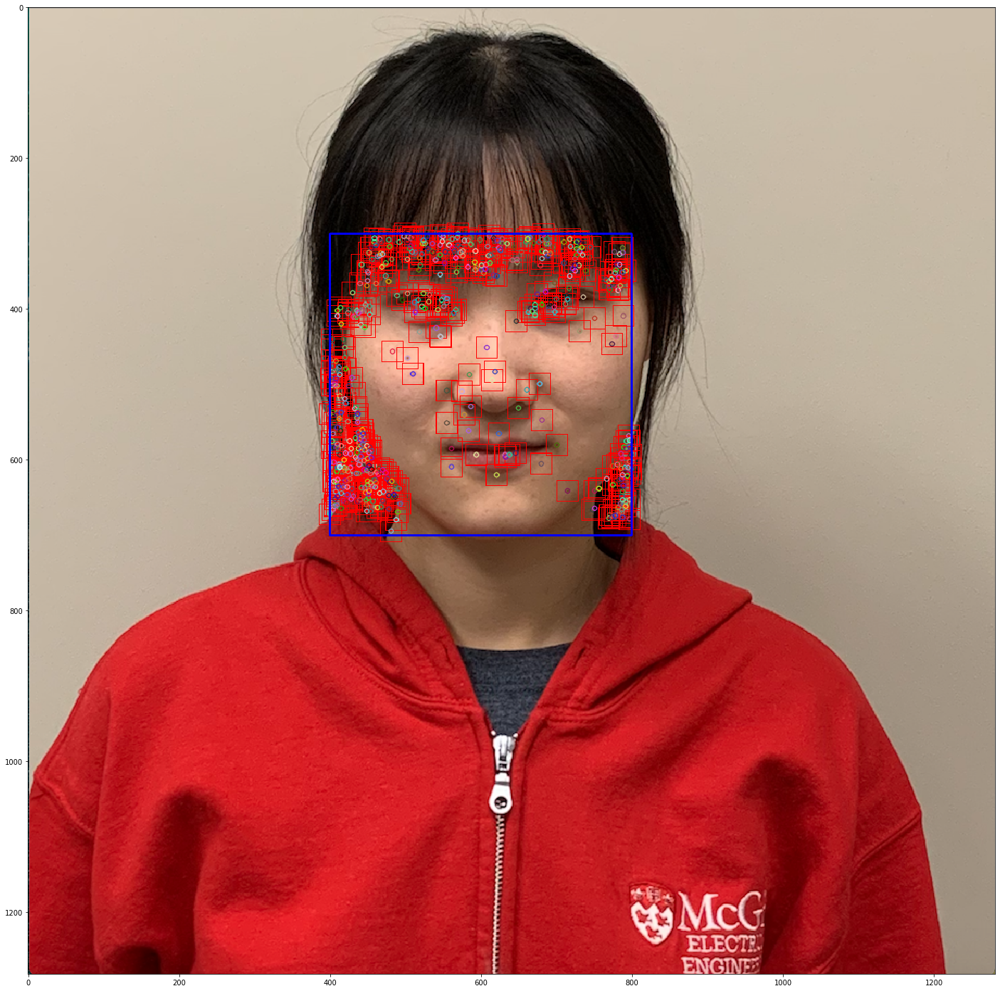

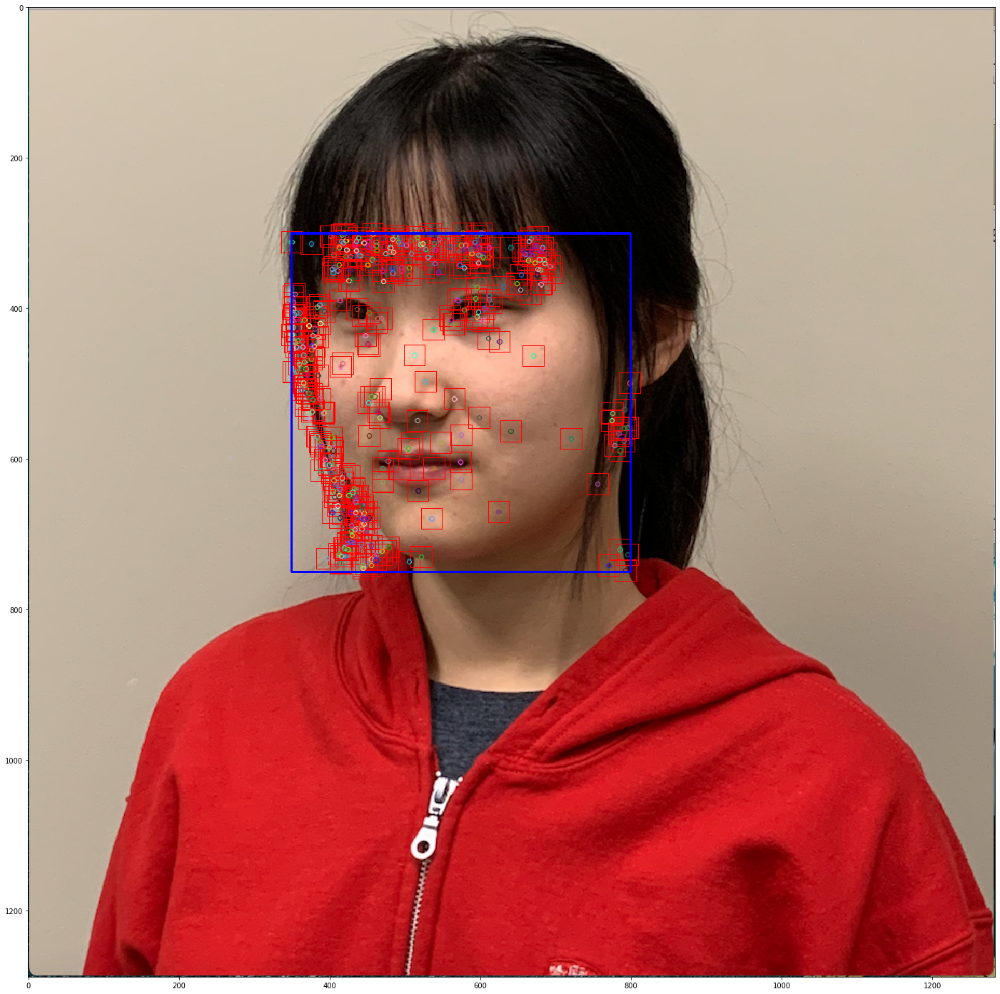

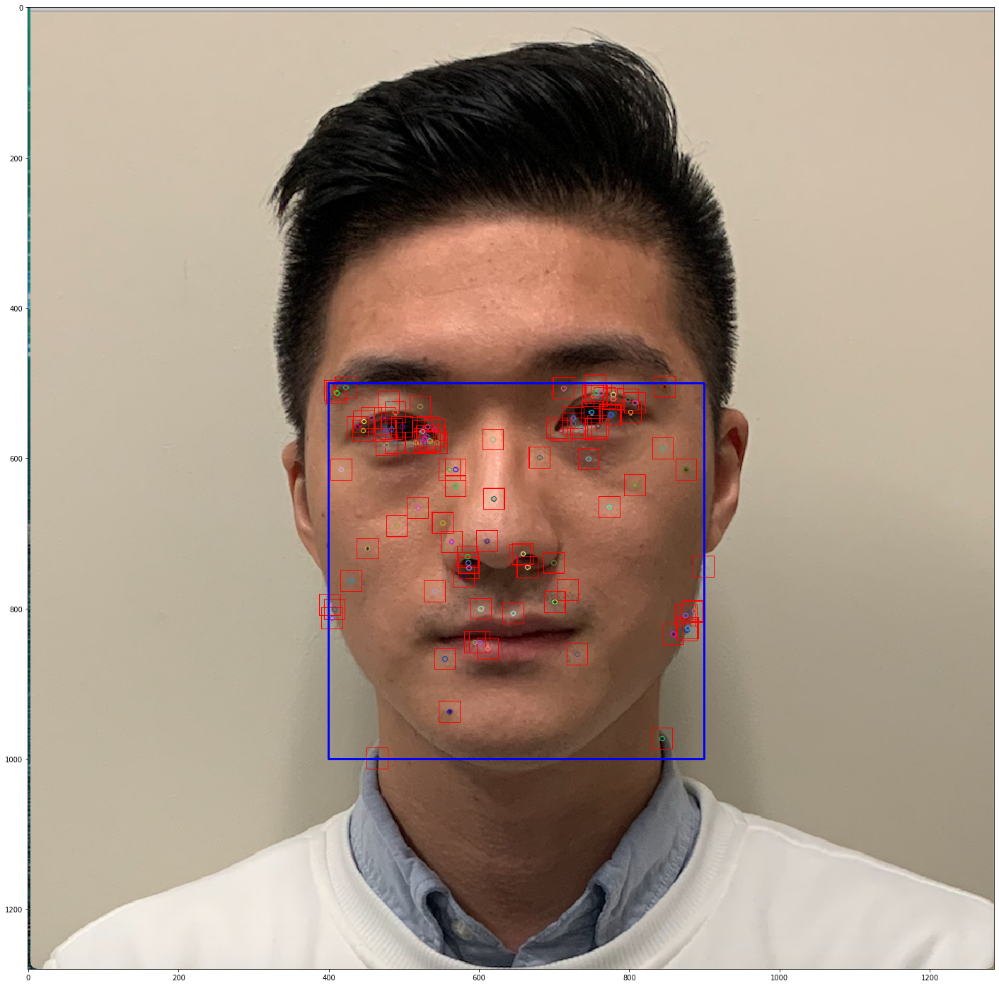

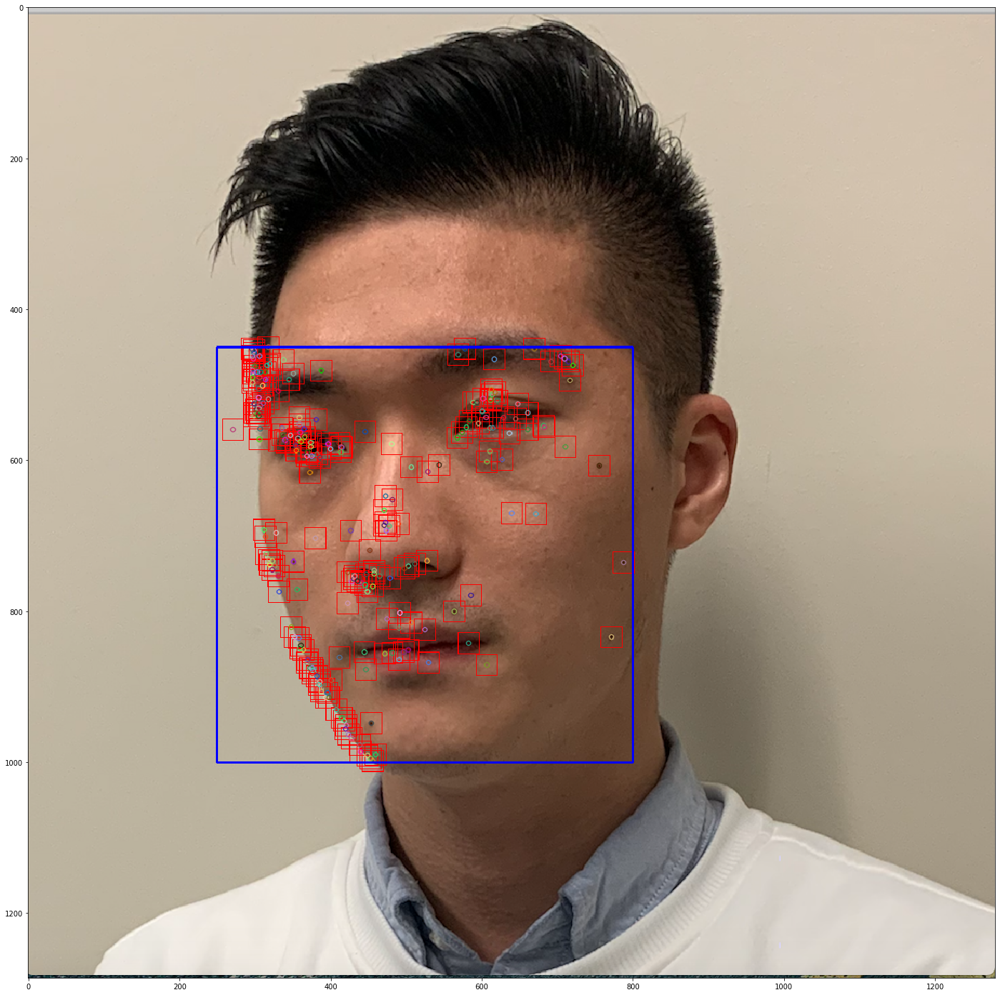

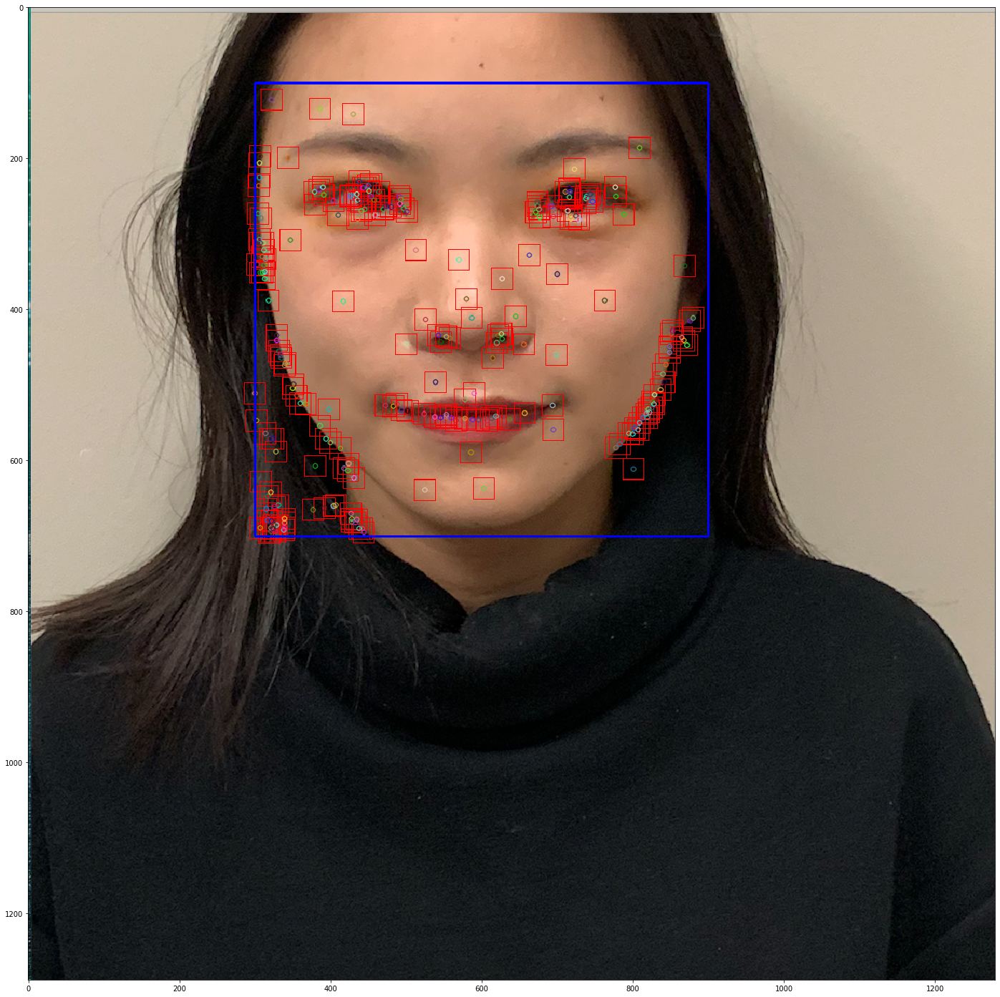

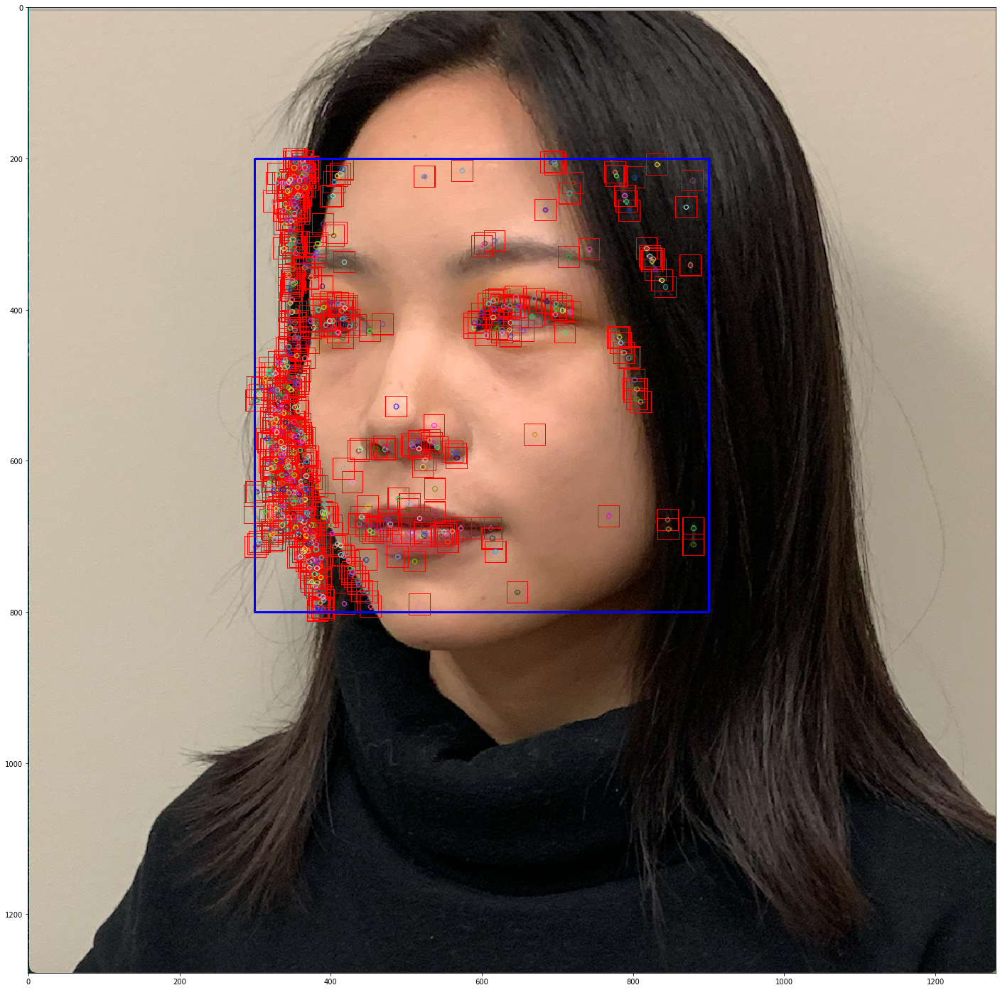

In [82]:
for name in dict_name:
    for imt in {"l30_large.png", "0_large.png"}:
        src = "Training_Images/" + name + "/" + imt
        img_tst_ = cv2.imread(src)
        img_tst_ = cv2.cvtColor(img_tst_, cv2.COLOR_RGB2BGR)
        img_tst = cv2.cvtColor(img_tst_, cv2.COLOR_BGR2GRAY)
        fclf = cv2.CascadeClassifier(r'./haarcascade_frontalface_default.xml')
        if src in dfxs:
            ulx, uly, dx, dy = dfxs[src]
        else:
            fxs = fclf.detectMultiScale(img_tst, scaleFactor=1.1, maxSize=(1000, 1000), minSize=(300, 300))
            ulx, uly, dx, dy = fxs[0]
        sift = cv2.xfeatures2d.SIFT_create()
        dup_disc = set()
        def filter_dup(kpt):
            if kpt.pt in dup_disc:
                return False
            else:
                dup_disc.add(kpt.pt)
                return ulx <= kpt.pt[0] and kpt.pt[0] <= ulx + dx and uly <= kpt.pt[1] and kpt.pt[1] <= uly + dy

        def discrete(kpt):
            kpt.pt = int(kpt.pt[0]), int(kpt.pt[1])
            return kpt
        kps = list(set(map(discrete, filter(filter_dup, sift.detect(img_tst, None)))))
        cnt = 0
        for kp in kps:
            cnt += 1
            img_tst_ = cv2.rectangle(img_tst_, 
                                     (int(kp.pt[0]) - 14, int(kp.pt[1]) - 14), 
                                     (int(kp.pt[0]) + 14, int(kp.pt[1]) + 14), 
                                     (255, 0, 0), 1)
        img_tst_ = cv2.drawKeypoints(img_tst_,kps,img_tst)
        img_tst_ = cv2.rectangle(img_tst_, (ulx, uly), (ulx + dx, uly + dy), (0, 0, 255), 2)
        plt.figure(figsize=(25,25))
        plt.imshow(img_tst_)
        plt.show()